In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import os
import shutil
import matplotlib.image as mpimg
import warnings
import gdown
import zipfile
import time
import pickle
warnings.filterwarnings('ignore')

from sklearn.model_selection import train_test_split
from sklearn.metrics import *

from skimage.io import imread

from google.colab import files
from google.colab import drive

from tensorflow.keras.models import Sequential
from tensorflow.keras.applications import VGG16
from tensorflow.keras.models import Model, load_model
from tensorflow.keras.optimizers import SGD,Adamax, AdamW,Adam
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.layers import Activation, Dropout, Flatten, Dense, Conv2D, MaxPool2D,BatchNormalization, GlobalAveragePooling2D
from tensorflow.keras.utils import image_dataset_from_directory, plot_model
from tensorflow.keras.preprocessing import image_dataset_from_directory, image
from tensorflow.keras.preprocessing.image import ImageDataGenerator, load_img

In [ ]:
url = 'https://drive.google.com/uc?id=1RrG4p1Rp7g5nYTmaLdKSN4VqwJm94-NH'

folder_img = 'banana-disease'
gdown.download(url, 'Dataset_Pisang.zip', quiet=False)


# Mengekstrak file zip
with zipfile.ZipFile('Dataset_Pisang.zip', 'r') as zip:
    zip.extractall(folder_img)

# Mengekstrak file zip dalam folder
inner_zip = [f for f in os.listdir(folder_img) if f.endswith('.zip')]
for zip_file in inner_zip:
    zip_file_path = os.path.join(folder_img, zip_file)
    with zipfile.ZipFile(zip_file_path, 'r') as zip:
        zip.extractall(folder_img)

Downloading...
From (original): https://drive.google.com/uc?id=1RrG4p1Rp7g5nYTmaLdKSN4VqwJm94-NH
From (redirected): https://drive.google.com/uc?id=1RrG4p1Rp7g5nYTmaLdKSN4VqwJm94-NH&confirm=t&uuid=973867d0-defa-423b-bd27-8dc99d4edb89
To: /content/Dataset_Pisang.zip
100%|██████████| 66.7M/66.7M [00:00<00:00, 99.7MB/s]


In [ ]:
file_url = "https://drive.google.com/uc?id=1-0uHuUQLTbEADyj7jYcDfGlBTMf9T_69"
output_path = "dataset_pisang.pkl"

# Unduh dari Google Drive
gdown.download(file_url, output_path, quiet=False)

# Load dataset
with open(output_path, "rb") as f:
    data = pickle.load(f)

train, val, test = data['train'], data['val'], data['test']

print("Dataset berhasil dimuat!")

Downloading...
From: https://drive.google.com/uc?id=1-0uHuUQLTbEADyj7jYcDfGlBTMf9T_69
To: /content/dataset_pisang.pkl
100%|██████████| 62.5k/62.5k [00:00<00:00, 39.4MB/s]

Dataset berhasil dimuat!


In [ ]:
# Augmentasi untuk data training
train_datagen = ImageDataGenerator(
    rescale=1./255,  # Normalisasi piksel ke [0, 1]
    rotation_range=15,  # Rotasi gambar hingga 15 derajat
    width_shift_range=0.2,  # Pergeseran horizontal hingga 20%
    height_shift_range=0.2,  # Pergeseran vertikal hingga 20%
    shear_range=0.1,  # Distorsi bentuk hingga 10%
    zoom_range=0.2,  # Zoom gambar hingga 20%
    horizontal_flip=True,  # Membalik gambar secara horizontal
    brightness_range=[0.7, 1.3],  # Variasi kecerahan
    fill_mode='nearest'  # Mode pengisian untuk area kosong
)

# Augmentasi untuk data validation (hanya rescale)
validation_datagen = ImageDataGenerator(
    rescale=1./255  # Normalisasi piksel ke [0, 1]
)

# Augmentasi untuk data testing (hanya rescale)
test_datagen = ImageDataGenerator(
    rescale=1./255  # Normalisasi piksel ke [0, 1]
)

# Generator data untuk training
train_generator = train_datagen.flow_from_dataframe(
    dataframe=train,  # DataFrame yang berisi path gambar dan label
    x_col='image_path',  # Kolom yang berisi path gambar
    y_col='class',  # Kolom yang berisi label kelas
    target_size=(224, 224),  # Ukuran gambar (sesuai input model, misalnya VGG16)
    batch_size=32,  # Ukuran batch
    class_mode='binary',  # Untuk klasifikasi multi-kelas (jika binary, gunakan 'binary')
    shuffle=True,  # Mengacak data sebelum setiap epoch
    seed=42  # Untuk memastikan reproduk
)

# Generator data untuk validation
validation_generator = validation_datagen.flow_from_dataframe(
    dataframe=val,
    x_col='image_path',
    y_col='class',
    target_size=(224, 224),
    batch_size=32,
    class_mode='binary',
    shuffle=False  # Jangan acak untuk evaluasi
)

# Generator data untuk testing
test_generator = test_datagen.flow_from_dataframe(
    dataframe=test,
    x_col='image_path',
    y_col='class',
    target_size=(224, 224),
    batch_size=32,
    class_mode='binary',
    shuffle=False  # Jangan acak untuk evaluasi
)

# Cek jumlah data di setiap generator
print(f"Jumlah data di training set: {train_generator.samples}")
print(f"Jumlah data di validation set: {validation_generator.samples}")
print(f"Jumlah data di test set: {test_generator.samples}")


Found 816 validated image filenames belonging to 2 classes.
Found 102 validated image filenames belonging to 2 classes.
Found 102 validated image filenames belonging to 2 classes.
Jumlah data di training set: 816
Jumlah data di validation set: 102
Jumlah data di test set: 102


In [ ]:
new_class_indices = {'Sehat': 0, 'Antraknosa': 1}
train_generator.class_indices = new_class_indices
validation_generator.class_indices =new_class_indices
test_generator.class_indices = new_class_indices

In [ ]:
labels = train['class'].map(new_class_indices).values
train_generator.classes = labels
labels = val['class'].map(new_class_indices).values
validation_generator.classes = labels
labels = test['class'].map(new_class_indices).values
test_generator.classes = labels

In [ ]:
den = 32
drop = 0.5
def create_custom_cnn(input_shape):
    model = Sequential([
        # Block 1
        Conv2D(64, kernel_size=(3, 3), padding='same', activation='relu', input_shape=input_shape, name='block1_conv1'),
        BatchNormalization(),
        Conv2D(64, kernel_size=(3, 3), padding='same', activation='relu', name='block1_conv2'),
        BatchNormalization(),
        MaxPool2D(pool_size=(2, 2), strides=(2, 2), name='block1_pool'),

        # Block 2
        Conv2D(128, kernel_size=(3, 3), padding='same', activation='relu', name='block2_conv1'),
        BatchNormalization(),
        Conv2D(128, kernel_size=(3, 3), padding='same', activation='relu', name='block2_conv2'),
        BatchNormalization(),
        MaxPool2D(pool_size=(2, 2), strides=(2, 2), name='block2_pool'),

        # Block 3
        Conv2D(256, kernel_size=(3, 3), padding='same', activation='relu', name='block3_conv1'),
        BatchNormalization(),
        Conv2D(256, kernel_size=(3, 3), padding='same', activation='relu', name='block3_conv2'),
        BatchNormalization(),
        MaxPool2D(pool_size=(2, 2), strides=(2, 2), name='block3_pool'),

        # Block 4
        Conv2D(512, kernel_size=(3, 3), padding='same', activation='relu', name='block4_conv1'),
        BatchNormalization(),
        Conv2D(512, kernel_size=(3, 3), padding='same', activation='relu', name='block4_conv2'),
        BatchNormalization(),
        MaxPool2D(pool_size=(2, 2), strides=(2, 2), name='block4_pool'),

        # Top layers
        Flatten(name='flatten'),
        Dense(den, activation='relu', name='fc1'),
        Dropout(drop, name='dropout'),
        Dense(1, activation='sigmoid', name='output')
    ])
    return model
def create_vgg16_model(fine_tune_at=None, input_shape=(224, 224, 3)):
    base_model = VGG16(weights='imagenet', include_top=False, input_shape=input_shape)
    base_model.trainable = False

    if fine_tune_at is not None:
        for layer in base_model.layers[fine_tune_at:]:
            layer.trainable = True

    x = base_model.output
    x = Flatten(name='flatten')(x)
    x = Dense(den, activation='relu', name='fc1')(x)
    x = Dropout(drop, name='dropout')(x)
    output = Dense(1, activation='sigmoid', name='output')(x)

    model = Model(inputs=base_model.input, outputs=output)
    return model


In [ ]:
models = {
    "CNN": create_custom_cnn(input_shape=(224, 224, 3)),
    "VGG16 FT": create_vgg16_model(fine_tune_at=15),
    "VGG16 FFE": create_vgg16_model()
}
histories = {}  # Untuk menyimpan riwayat pelatihan
results = {}  # Untuk menyimpan hasil evaluasi
training_times = {}


58889256/58889256 ━━━━━━━━━━━━━━━━━━━━ 4s 0us/step


In [ ]:
for model_name, model in models.items():
    print(f"Model Summary for: {model_name}")
    model.summary()
    print("-" * 50)

Model Summary for: CNN


Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ block1_conv1 (Conv2D)                │ (None, 224, 224, 64)        │           1,792 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization                  │ (None, 224, 224, 64)        │             256 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_conv2 (Conv2D)                │ (None, 224, 224, 64)        │          36,928 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_1                │ (None, 224, 224, 64)        │             256 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_pool (MaxPooling2D)           │ (None, 112, 112, 64)        │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_conv1 (Conv2D)                │ (None, 112, 112, 128)       │          73,856 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_2                │ (None, 112, 112, 128)       │             512 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_conv2 (Conv2D)                │ (None, 112, 112, 128)       │         147,584 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_3                │ (None, 112, 112, 128)       │             512 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_pool (MaxPooling2D)           │ (None, 56, 56, 128)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv1 (Conv2D)                │ (None, 56, 56, 256)         │         295,168 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_4                │ (None, 56, 56, 256)         │           1,024 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv2 (Conv2D)                │ (None, 56, 56, 256)         │         590,080 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_5                │ (None, 56, 56, 256)         │           1,024 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_pool (MaxPooling2D)           │ (None, 28, 28, 256)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv1 (Conv2D)                │ (None, 28, 28, 512)         │       1,180,160 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_6                │ (None, 28, 28, 512)         │           2,048 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv2 (Conv2D)                │ (None, 28, 28, 512)         │       2,359,8

 Total params: 7,904,385 (30.15 MB)

 Trainable params: 7,900,545 (30.14 MB)

 Non-trainable params: 3,840 (15.00 KB)

--------------------------------------------------
Model Summary for: VGG16 FT


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer_1 (InputLayer)           │ (None, 224, 224, 3)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_conv1 (Conv2D)                │ (None, 224, 224, 64)        │           1,792 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_conv2 (Conv2D)                │ (None, 224, 224, 64)        │          36,928 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_pool (MaxPooling2D)           │ (None, 112, 112, 64)        │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_conv1 (Conv2D)                │ (None, 112, 112, 128)       │          73,856 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_conv2 (Conv2D)                │ (None, 112, 112, 128)       │         147,584 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_pool (MaxPooling2D)           │ (None, 56, 56, 128)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv1 (Conv2D)                │ (None, 56, 56, 256)         │         295,168 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv2 (Conv2D)                │ (None, 56, 56, 256)         │         590,080 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv3 (Conv2D)                │ (None, 56, 56, 256)         │         590,080 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_pool (MaxPooling2D)           │ (None, 28, 28, 256)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv1 (Conv2D)                │ (None, 28, 28, 512)         │       1,180,160 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv2 (Conv2D)                │ (None, 28, 28, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv3 (Conv2D)                │ (None, 28, 28, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_pool (MaxPooling2D)           │ (None, 14, 14, 512)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_conv1 (Conv2D)                │ (None, 14, 14, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_conv2 (Conv2D)                │ (None, 14, 14, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_conv3 (Conv2D)                │ (None, 14, 14, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_pool (MaxPooling2D)           │ (None, 7, 7, 512)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten (Flatten)                    │ (None, 25088)               │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ fc1 (Dense)                          │ (None, 32)                  │         802,848 │
├──────────────────────────────────────┼─────────────────────────────┼──────────────

 Total params: 15,517,569 (59.19 MB)

 Trainable params: 7,882,305 (30.07 MB)

 Non-trainable params: 7,635,264 (29.13 MB)

--------------------------------------------------
Model Summary for: VGG16 FFE


Model: "functional_2"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer_2 (InputLayer)           │ (None, 224, 224, 3)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_conv1 (Conv2D)                │ (None, 224, 224, 64)        │           1,792 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_conv2 (Conv2D)                │ (None, 224, 224, 64)        │          36,928 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_pool (MaxPooling2D)           │ (None, 112, 112, 64)        │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_conv1 (Conv2D)                │ (None, 112, 112, 128)       │          73,856 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_conv2 (Conv2D)                │ (None, 112, 112, 128)       │         147,584 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_pool (MaxPooling2D)           │ (None, 56, 56, 128)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv1 (Conv2D)                │ (None, 56, 56, 256)         │         295,168 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv2 (Conv2D)                │ (None, 56, 56, 256)         │         590,080 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv3 (Conv2D)                │ (None, 56, 56, 256)         │         590,080 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_pool (MaxPooling2D)           │ (None, 28, 28, 256)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv1 (Conv2D)                │ (None, 28, 28, 512)         │       1,180,160 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv2 (Conv2D)                │ (None, 28, 28, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv3 (Conv2D)                │ (None, 28, 28, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_pool (MaxPooling2D)           │ (None, 14, 14, 512)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_conv1 (Conv2D)                │ (None, 14, 14, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_conv2 (Conv2D)                │ (None, 14, 14, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_conv3 (Conv2D)                │ (None, 14, 14, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_pool (MaxPooling2D)           │ (None, 7, 7, 512)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten (Flatten)                    │ (None, 25088)               │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ fc1 (Dense)                          │ (None, 32)                  │         802,848 │
├──────────────────────────────────────┼─────────────────────────────┼──────────────

 Total params: 15,517,569 (59.19 MB)

 Trainable params: 802,881 (3.06 MB)

 Non-trainable params: 14,714,688 (56.13 MB)

--------------------------------------------------


In [ ]:
for name, model in models.items():
    if name == "CNN":
      num = 20
    else:
      num = 5
    model.compile(
        optimizer=Adam(learning_rate=1e-3),
        loss='binary_crossentropy',
        metrics=['accuracy']
    )

    es = EarlyStopping(monitor='val_loss', patience=num, restore_best_weights=True, verbose=1)
    print(f"Training {name}...")
    start_time = time.time()
    history = model.fit(
        train_generator,
        validation_data=validation_generator,
        epochs=40,
        callbacks=[es],
        verbose=1
    )
    end_time = time.time()
    histories[name] = history
    training_times[name] = end_time - start_time

    print(f"{name} training selesai.")

Training CNN...
Epoch 1/40
26/26 ━━━━━━━━━━━━━━━━━━━━ 101s 2s/step - accuracy: 0.6762 - loss: 5.4981 - val_accuracy: 0.4314 - val_loss: 16.3392
Epoch 2/40
26/26 ━━━━━━━━━━━━━━━━━━━━ 16s 620ms/step - accuracy: 0.8595 - loss: 1.8165 - val_accuracy: 0.5196 - val_loss: 0.9345
Epoch 3/40
26/26 ━━━━━━━━━━━━━━━━━━━━ 17s 638ms/step - accuracy: 0.8117 - loss: 1.2747 - val_accuracy: 0.5000 - val_loss: 51.5517
Epoch 4/40
26/26 ━━━━━━━━━━━━━━━━━━━━ 16s 625ms/step - accuracy: 0.8530 - loss: 0.6816 - val_accuracy: 0.5000 - val_loss: 5.7409
Epoch 5/40
26/26 ━━━━━━━━━━━━━━━━━━━━ 17s 632ms/step - accuracy: 0.8839 - loss: 0.4350 - val_accuracy: 0.5000 - val_loss: 10.1280
Epoch 6/40
26/26 ━━━━━━━━━━━━━━━━━━━━ 16s 613ms/step - accuracy: 0.9217 - loss: 0.6373 - val_accuracy: 0.5000 - val_loss: 2.7778
Epoch 7/40
26/26 ━━━━━━━━━━━━━━━━━━━━ 18s 670ms/step - accuracy: 0.8787 - loss: 0.4615 - val_accuracy: 0.5000 - val_loss: 10.1571
Epoch 8/40
26/26 ━━━━━━━━━━━━━━━━━━━━ 19s 620ms/step - accuracy: 0.8650 - loss:

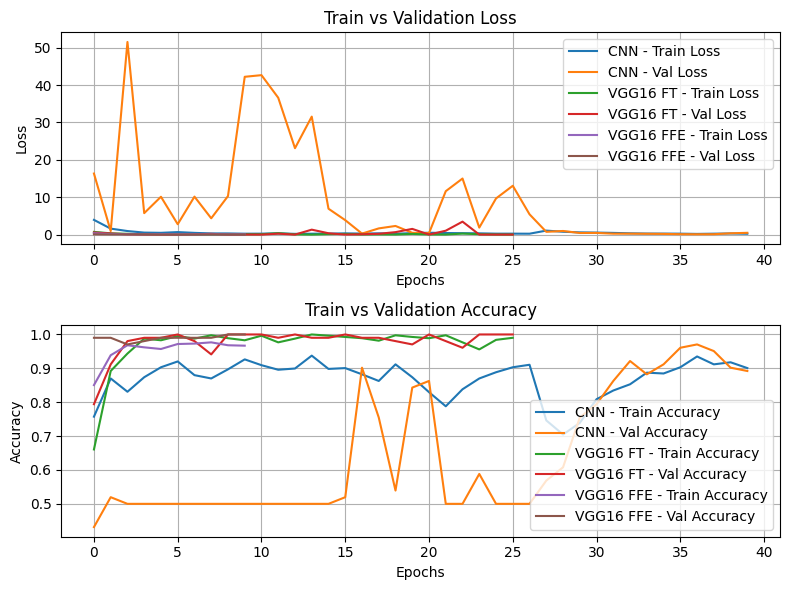

In [ ]:
def plot_training(histories):
    plt.figure(figsize=(8, 6))

    # Subplot untuk Loss
    plt.subplot(2, 1, 1)
    for name, history in histories.items():
        plt.plot(history.history['loss'], label=f"{name} - Train Loss")
        plt.plot(history.history['val_loss'], label=f"{name} - Val Loss")
    plt.title("Train vs Validation Loss")
    plt.xlabel("Epochs")
    plt.ylabel("Loss")
    plt.legend()
    plt.grid(True)

    # Subplot untuk Accuracy
    plt.subplot(2, 1, 2)
    for name, history in histories.items():
        plt.plot(history.history['accuracy'], label=f"{name} - Train Accuracy")
        plt.plot(history.history['val_accuracy'], label=f"{name} - Val Accuracy")
    plt.title("Train vs Validation Accuracy")
    plt.xlabel("Epochs")
    plt.ylabel("Accuracy")
    plt.legend()
    plt.grid(True)

    # Tampilkan grafik
    plt.tight_layout()
    plt.show()

# Menampilkan grafik pelatihan
plot_training(histories)

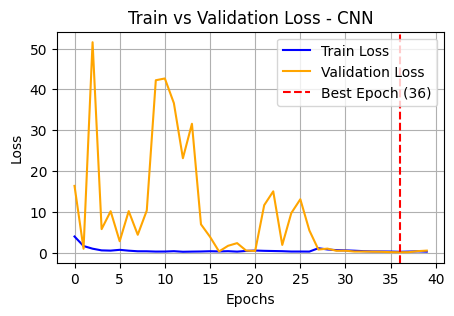

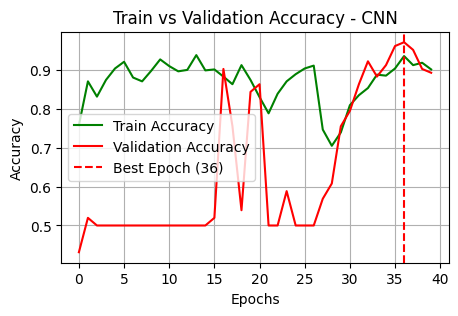

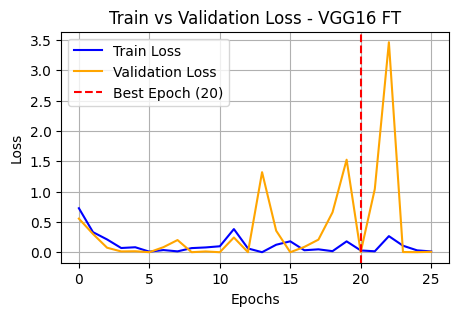

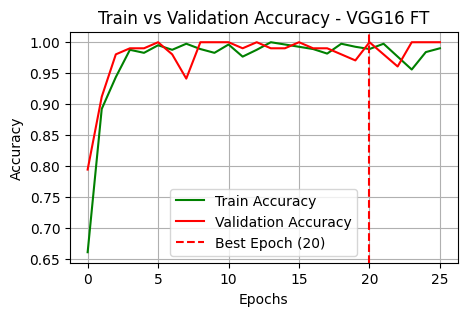

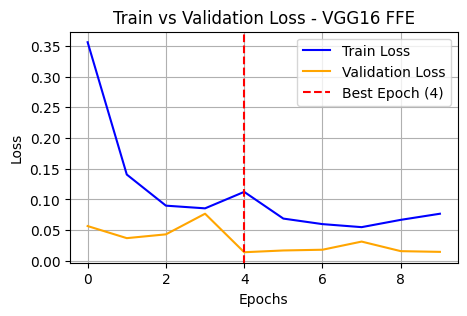

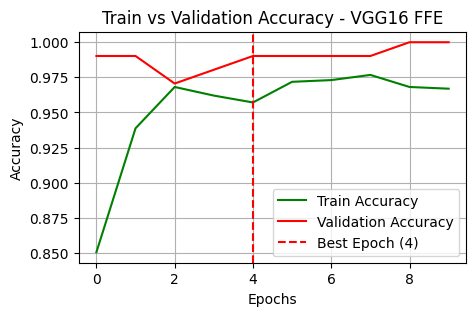

In [ ]:
def plot_individual_training(histories):
    """
    Menampilkan grafik pelatihan secara terpisah untuk setiap model.
    Args:
        histories (dict): Dictionary dengan nama model sebagai kunci dan history pelatihan sebagai nilai.
    """
    for name, history in histories.items():
        plt.figure(figsize=(5, 3))

        # Subplot untuk Loss
        plt.plot(history.history['loss'], label="Train Loss", color='blue')
        plt.plot(history.history['val_loss'], label="Validation Loss", color='orange')
        best_epoch = np.argmin(history.history['val_loss'])
        plt.axvline(x=best_epoch, color='red', linestyle='--', label=f'Best Epoch ({best_epoch})')
        plt.title(f"Train vs Validation Loss - {name}")
        plt.xlabel("Epochs")
        plt.ylabel("Loss")
        plt.legend()
        plt.grid(True)
        plt.show()

        # Subplot untuk Accuracy
        plt.figure(figsize=(5, 3))
        plt.plot(history.history['accuracy'], label="Train Accuracy", color='green')
        plt.plot(history.history['val_accuracy'], label="Validation Accuracy", color='red')
        plt.axvline(x=best_epoch, color='red', linestyle='--', label=f'Best Epoch ({best_epoch})')
        plt.title(f"Train vs Validation Accuracy - {name}")
        plt.xlabel("Epochs")
        plt.ylabel("Accuracy")
        plt.legend()
        plt.grid(True)
        plt.show()

# Menampilkan grafik pelatihan secara individu untuk setiap model
plot_individual_training(histories)

Evaluating CNN...
4/4 ━━━━━━━━━━━━━━━━━━━━ 1s 105ms/step - accuracy: 0.9512 - loss: 0.1215
4/4 ━━━━━━━━━━━━━━━━━━━━ 2s 346ms/step


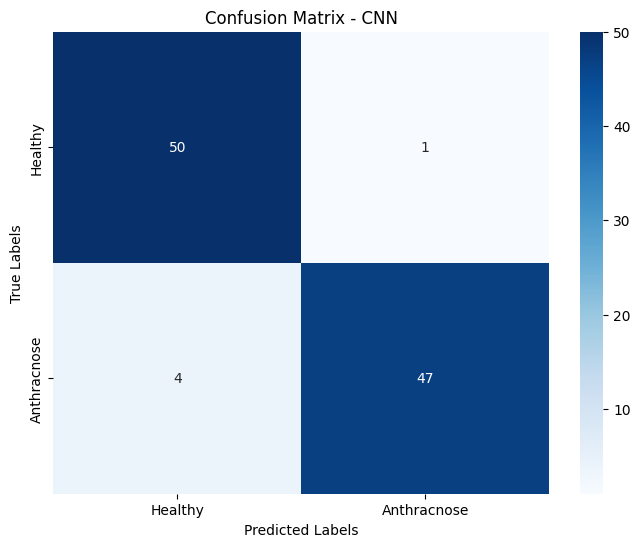

Classification Report - CNN
              precision    recall  f1-score   support

     Healthy       0.93      0.98      0.95        51
 Anthracnose       0.98      0.92      0.95        51

    accuracy                           0.95       102
   macro avg       0.95      0.95      0.95       102
weighted avg       0.95      0.95      0.95       102

Evaluating VGG16 FT...
4/4 ━━━━━━━━━━━━━━━━━━━━ 1s 127ms/step - accuracy: 1.0000 - loss: 1.6795e-17
4/4 ━━━━━━━━━━━━━━━━━━━━ 2s 312ms/step


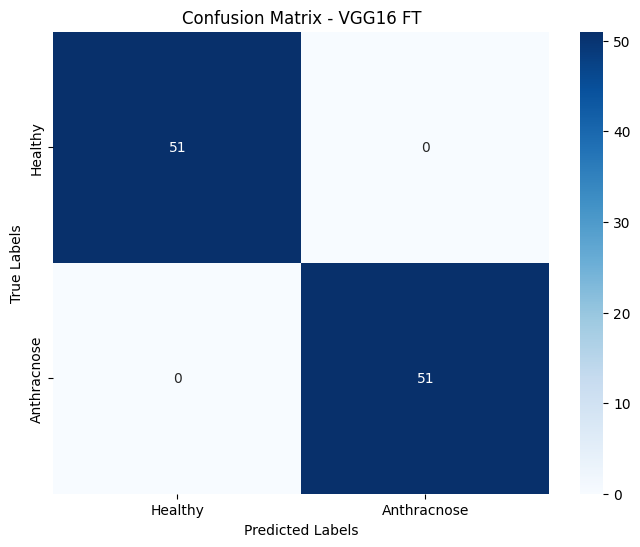

Classification Report - VGG16 FT
              precision    recall  f1-score   support

     Healthy       1.00      1.00      1.00        51
 Anthracnose       1.00      1.00      1.00        51

    accuracy                           1.00       102
   macro avg       1.00      1.00      1.00       102
weighted avg       1.00      1.00      1.00       102

Evaluating VGG16 FFE...
4/4 ━━━━━━━━━━━━━━━━━━━━ 1s 125ms/step - accuracy: 1.0000 - loss: 0.0080


3/4 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step

4/4 ━━━━━━━━━━━━━━━━━━━━ 2s 293ms/step


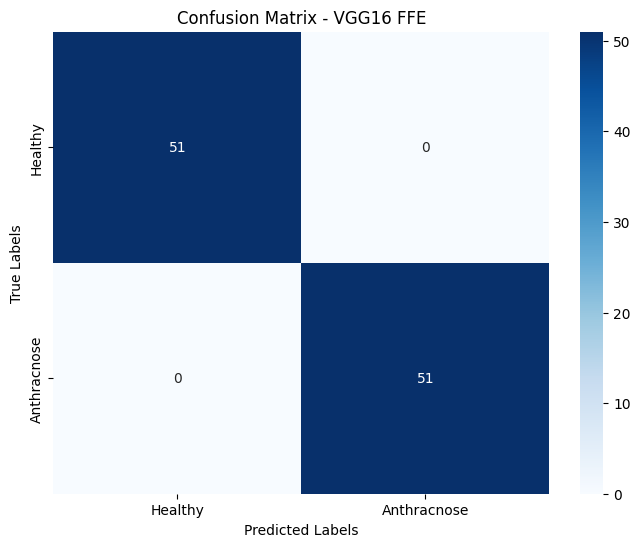

Classification Report - VGG16 FFE
              precision    recall  f1-score   support

     Healthy       1.00      1.00      1.00        51
 Anthracnose       1.00      1.00      1.00        51

    accuracy                           1.00       102
   macro avg       1.00      1.00      1.00       102
weighted avg       1.00      1.00      1.00       102


Model Evaluation Results:
CNN: Loss = 0.1135, Accuracy = 0.9510
VGG16 FT: Loss = 0.0000, Accuracy = 1.0000
VGG16 FFE: Loss = 0.0098, Accuracy = 1.0000


In [ ]:
for name, model in models.items():
    print(f"Evaluating {name}...")

    # Evaluasi pada data uji
    result = model.evaluate(test_generator, verbose=1)  # Ganti test_generator dengan data pengujian Anda
    results[name] = {"loss": result[0], "accuracy": result[1]}

    # Prediksi pada data uji
    y_true = test_generator.classes  # Label asli
    y_pred_probs = model.predict(test_generator)  # Probabilitas prediksi
    y_pred = (y_pred_probs > 0.5).astype(int).flatten()  # Konversi ke label biner

    # Confusion Matrix
    cm = confusion_matrix(y_true, y_pred)
    plt.figure(figsize=(8, 6))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=['Healthy' 'Anthracnose'],
                yticklabels=['Healthy', 'Anthracnose'])
    plt.title(f"Confusion Matrix - {name}")
    plt.xlabel("Predicted Labels")
    plt.ylabel("True Labels")
    plt.show()

    # Classification Report
    print(f"Classification Report - {name}")
    print(classification_report(y_true, y_pred, target_names=['Healthy', 'Anthracnose']))

# Menampilkan hasil evaluasi
print("\nModel Evaluation Results:")
for name, metrics in results.items():
    print(f"{name}: Loss = {metrics['loss']:.4f}, Accuracy = {metrics['accuracy']:.4f}")

In [ ]:
# Menampilkan waktu pelatihan untuk setiap model
print("\nTraining Times:")
for name, time_taken in training_times.items():
    print(f"{name}: {time_taken:.2f} seconds")


Training Times:
CNN: 779.43 seconds
VGG16 FT: 422.69 seconds
VGG16 FFE: 159.64 seconds


In [ ]:
models

{'CNN': <Sequential name=sequential, built=True>,
 'VGG16 FT': <Functional name=functional_1, built=True>,
 'VGG16 FFE': <Functional name=functional_2, built=True>}

4/4 ━━━━━━━━━━━━━━━━━━━━ 2s 350ms/step
Image 1: Path = Pisang Sehat (104).jpg, True Label = Sehat, Predicted Label = Sehat, Probability = 0.0000
Image 2: Path = Antraknosa (249).jpg, True Label = Antraknosa, Predicted Label = Antraknosa, Probability = 1.0000
Image 3: Path = Antraknosa (28).jpg, True Label = Antraknosa, Predicted Label = Antraknosa, Probability = 1.0000
Image 4: Path = Pisang Sehat (404).jpg, True Label = Sehat, Predicted Label = Sehat, Probability = 0.0598
Image 5: Path = Pisang Sehat (464).jpg, True Label = Sehat, Predicted Label = Sehat, Probability = 0.0000
Image 6: Path = Pisang Sehat (65).jpg, True Label = Sehat, Predicted Label = Sehat, Probability = 0.0000
Image 7: Path = Pisang Sehat (217).jpg, True Label = Sehat, Predicted Label = Sehat, Probability = 0.0000
Image 8: Path = Antraknosa (464).jpg, True Label = Antraknosa, Predicted Label = Antraknosa, Probability = 1.0000
Image 9: Path = Pisang Sehat (309).jpg, True Label = Sehat, Predicted Label = Sehat, Probab

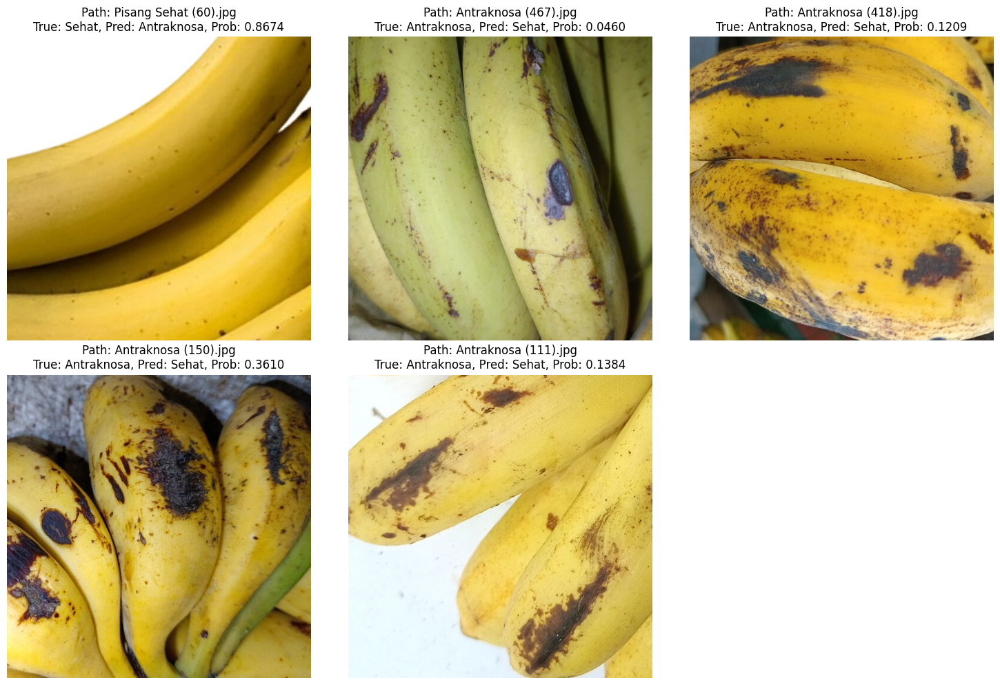

4/4 ━━━━━━━━━━━━━━━━━━━━ 2s 371ms/step
Image 1: Path = Pisang Sehat (104).jpg, True Label = Sehat, Predicted Label = Sehat, Probability = 0.0000
Image 2: Path = Antraknosa (249).jpg, True Label = Antraknosa, Predicted Label = Antraknosa, Probability = 1.0000
Image 3: Path = Antraknosa (28).jpg, True Label = Antraknosa, Predicted Label = Antraknosa, Probability = 1.0000
Image 4: Path = Pisang Sehat (404).jpg, True Label = Sehat, Predicted Label = Sehat, Probability = 0.0000
Image 5: Path = Pisang Sehat (464).jpg, True Label = Sehat, Predicted Label = Sehat, Probability = 0.0000
Image 6: Path = Pisang Sehat (65).jpg, True Label = Sehat, Predicted Label = Sehat, Probability = 0.0000
Image 7: Path = Pisang Sehat (217).jpg, True Label = Sehat, Predicted Label = Sehat, Probability = 0.0000
Image 8: Path = Antraknosa (464).jpg, True Label = Antraknosa, Predicted Label = Antraknosa, Probability = 1.0000
Image 9: Path = Pisang Sehat (309).jpg, True Label = Sehat, Predicted Label = Sehat, Probab

In [ ]:
for name, model in models.items():
    # Validasi bahwa generator mendukung indexing
    if not hasattr(test_generator, '__getitem__'):
        raise ValueError("Generator tidak mendukung akses indexing.")

    # Menggabungkan seluruh batch dari generator menjadi satu array
    x_all, y_all = [], []
    for i in range(len(test_generator)):
        x_batch, y_batch = test_generator[i]
        x_all.append(x_batch)
        y_all.append(y_batch)

    # Mengonversi list menjadi numpy array
    x_all = np.concatenate(x_all, axis=0)
    y_all = np.concatenate(y_all, axis=0)

    # Melakukan prediksi untuk seluruh dataset
    predictions_prob = model.predict(x_all)  # Probabilitas prediksi
    predictions = (predictions_prob > 0.5).astype(int).flatten()  # Konversi ke label biner

    # Menampilkan hasil prediksi untuk seluruh gambar
    for i, img_path in enumerate(test_generator.filepaths):
        # Label asli
        true_label = 'Sehat' if y_all[i] == 0 else 'Antraknosa'
        # Label prediksi
        pred_label = 'Sehat' if predictions[i] == 0 else 'Antraknosa'

        print(f"Image {i+1}: Path = {os.path.basename(img_path)}, True Label = {true_label}, "
              f"Predicted Label = {pred_label}, Probability = {predictions_prob[i][0]:.4f}")

    # Identifikasi indeks gambar yang salah diprediksi
    misclassified_indices = np.where(predictions != y_all)[0]

    if len(misclassified_indices) > 0:
        print("\nGambar yang Salah Diprediksi:")
        plt.figure(figsize=(15, 5 * ((len(misclassified_indices) + 2) // 3)))  # Penyesuaian ukuran
        for i, index in enumerate(misclassified_indices):
            img_path = test_generator.filepaths[index]
            true_label = 'Sehat' if y_all[index] == 0 else 'Antraknosa'
            pred_label = 'Sehat' if predictions[index] == 0 else 'Antraknosa'
            prob = predictions_prob[index][0]

            plt.subplot((len(misclassified_indices) + 2) // 3, 3, i + 1)
            img = plt.imread(img_path)
            plt.imshow(img)
            plt.title(f"Path: {os.path.basename(img_path)}\nTrue: {true_label}, Pred: {pred_label}, Prob: {prob:.4f}")
            plt.axis('off')
        plt.tight_layout()
        plt.show()
    else:
        print("\nTidak ada gambar yang salah diprediksi.")


Saving WhatsApp Image 2024-12-03 at 08.48.43_51a88009.jpg to WhatsApp Image 2024-12-03 at 08.48.43_51a88009.jpg
Predicting images using VGG16 FT model...
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step


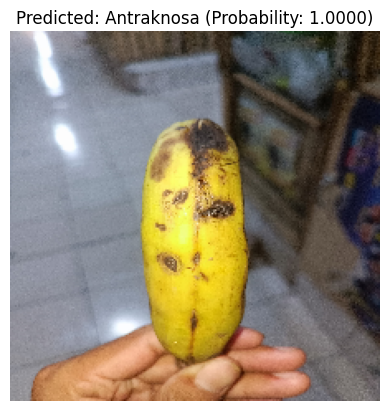

Predicted Label: Antraknosa
Prediction Probability: 1.0000
Predicting images using CNN model...
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


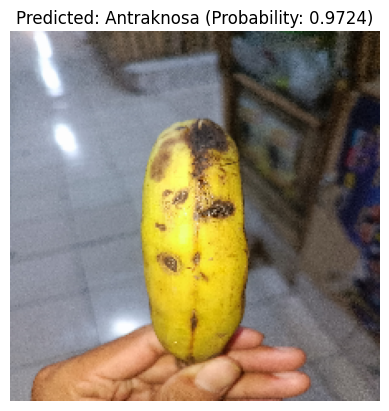

Predicted Label: Antraknosa
Prediction Probability: 0.9724
Predicting images using VGG16 FFE model...
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 567ms/step


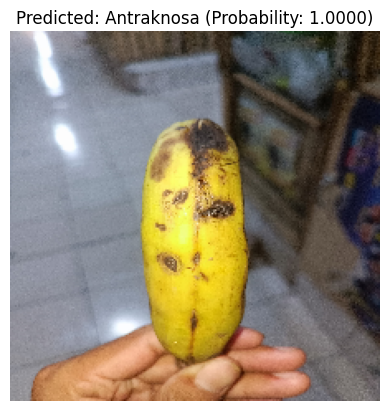

Predicted Label: Antraknosa
Prediction Probability: 1.0000


In [ ]:
def predict_image(model, img_path):
    # Memuat gambar
    img = image.load_img(img_path, target_size=(224, 224))  # Resize gambar sesuai dengan input model
    img_array = image.img_to_array(img)  # Mengubah gambar menjadi array numpy
    img_array = np.expand_dims(img_array, axis=0)  # Menambahkan batch dimension (model mengharapkan dimensi batch)
    img_array = img_array / 255.0  # Normalisasi piksel gambar ke rentang [0, 1]

    # Melakukan prediksi
    prediction_prob = model.predict(img_array)
    prediction = (prediction_prob > 0.5).astype(int).flatten()  # Menggunakan threshold 0.5 untuk klasifikasi biner

    # Menentukan label berdasarkan prediksi
    label = 'Sehat' if prediction == 0 else 'Antraknosa'
    probability = prediction_prob[0][0]

    return label, probability

# Mengunggah gambar
uploaded = files.upload()  # Memungkinkan pengguna mengunggah file
img_path = next(iter(uploaded))  # Mengambil nama file pertama dari yang diunggah

# Melakukan prediksi
for name, model in models.items():
  print(f"Predicting images using {name} model...")
  label, probability = predict_image(model, img_path)

  # Menampilkan gambar dan hasil prediksi
  img = image.load_img(img_path, target_size=(224, 224))  # Memuat gambar untuk ditampilkan
  plt.imshow(img)
  plt.axis('off')  # Menyembunyikan axis
  plt.title(f"Predicted: {label} (Probability: {probability:.4f})")
  plt.show()

  print(f"Predicted Label: {label}")
  print(f"Prediction Probability: {probability:.4f}")

Saving Gemini_Generated_Image_fvut0afvut0afvut.jpeg to Gemini_Generated_Image_fvut0afvut0afvut.jpeg
Predicting images using VGG16 FT model...
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step


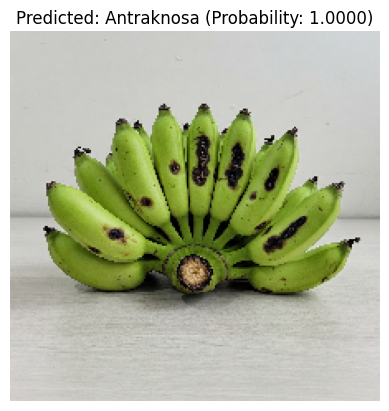

Predicted Label: Antraknosa
Prediction Probability: 1.0000
Predicting images using CNN model...
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 810ms/step


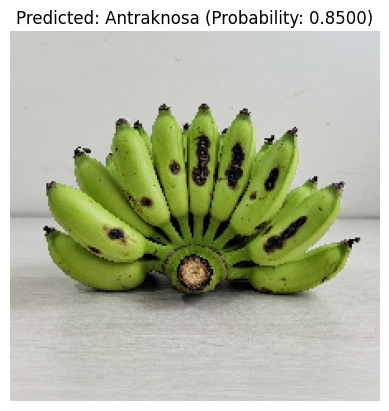

Predicted Label: Antraknosa
Prediction Probability: 0.8500
Predicting images using VGG16 FFE model...
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 550ms/step


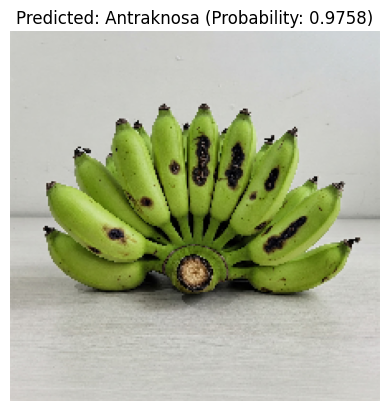

Predicted Label: Antraknosa
Prediction Probability: 0.9758


In [ ]:
def predict_image(model, img_path):
    # Memuat gambar
    img = image.load_img(img_path, target_size=(224, 224))  # Resize gambar sesuai dengan input model
    img_array = image.img_to_array(img)  # Mengubah gambar menjadi array numpy
    img_array = np.expand_dims(img_array, axis=0)  # Menambahkan batch dimension (model mengharapkan dimensi batch)
    img_array = img_array / 255.0  # Normalisasi piksel gambar ke rentang [0, 1]

    # Melakukan prediksi
    prediction_prob = model.predict(img_array)
    prediction = (prediction_prob > 0.5).astype(int).flatten()  # Menggunakan threshold 0.5 untuk klasifikasi biner

    # Menentukan label berdasarkan prediksi
    label = 'Sehat' if prediction == 0 else 'Antraknosa'
    probability = prediction_prob[0][0]

    return label, probability

# Mengunggah gambar
uploaded = files.upload()  # Memungkinkan pengguna mengunggah file
img_path = next(iter(uploaded))  # Mengambil nama file pertama dari yang diunggah

# Melakukan prediksi
for name, model in models.items():
  print(f"Predicting images using {name} model...")
  label, probability = predict_image(model, img_path)

  # Menampilkan gambar dan hasil prediksi
  img = image.load_img(img_path, target_size=(224, 224))  # Memuat gambar untuk ditampilkan
  plt.imshow(img)
  plt.axis('off')  # Menyembunyikan axis
  plt.title(f"Predicted: {label} (Probability: {probability:.4f})")
  plt.show()

  print(f"Predicted Label: {label}")
  print(f"Prediction Probability: {probability:.4f}")

Saving pisang-ambon-super_700x.webp to pisang-ambon-super_700x.webp
Predicting images using VGG16 FT model...
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step


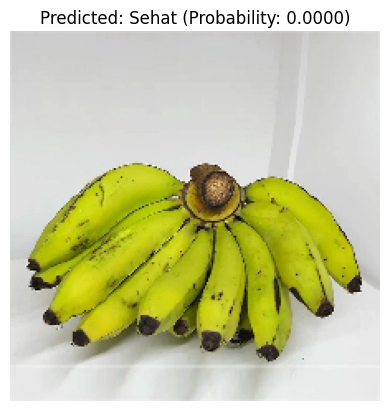

Predicted Label: Sehat
Prediction Probability: 0.0000
Predicting images using CNN model...
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 828ms/step


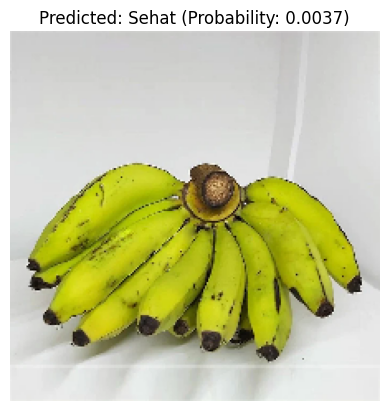

Predicted Label: Sehat
Prediction Probability: 0.0037
Predicting images using VGG16 FFE model...
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 590ms/step


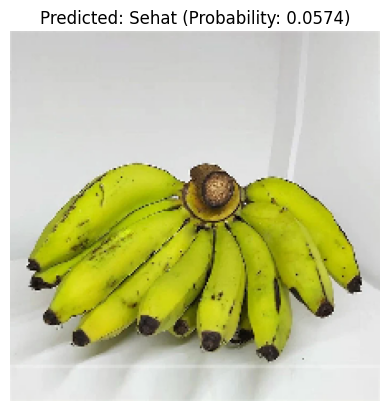

Predicted Label: Sehat
Prediction Probability: 0.0574


In [ ]:
def predict_image(model, img_path):
    # Memuat gambar
    img = image.load_img(img_path, target_size=(224, 224))  # Resize gambar sesuai dengan input model
    img_array = image.img_to_array(img)  # Mengubah gambar menjadi array numpy
    img_array = np.expand_dims(img_array, axis=0)  # Menambahkan batch dimension (model mengharapkan dimensi batch)
    img_array = img_array / 255.0  # Normalisasi piksel gambar ke rentang [0, 1]

    # Melakukan prediksi
    prediction_prob = model.predict(img_array)
    prediction = (prediction_prob > 0.5).astype(int).flatten()  # Menggunakan threshold 0.5 untuk klasifikasi biner

    # Menentukan label berdasarkan prediksi
    label = 'Sehat' if prediction == 0 else 'Antraknosa'
    probability = prediction_prob[0][0]

    return label, probability

# Mengunggah gambar
uploaded = files.upload()  # Memungkinkan pengguna mengunggah file
img_path = next(iter(uploaded))  # Mengambil nama file pertama dari yang diunggah

# Melakukan prediksi
for name, model in models.items():
  print(f"Predicting images using {name} model...")
  label, probability = predict_image(model, img_path)

  # Menampilkan gambar dan hasil prediksi
  img = image.load_img(img_path, target_size=(224, 224))  # Memuat gambar untuk ditampilkan
  plt.imshow(img)
  plt.axis('off')  # Menyembunyikan axis
  plt.title(f"Predicted: {label} (Probability: {probability:.4f})")
  plt.show()

  print(f"Predicted Label: {label}")
  print(f"Prediction Probability: {probability:.4f}")

Saving Gemini_Generated_Image_ur8h84ur8h84ur8h.jpeg to Gemini_Generated_Image_ur8h84ur8h84ur8h.jpeg
Predicting images using VGG16 FT model...
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step


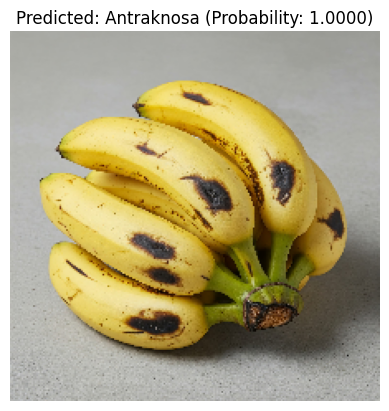

Predicted Label: Antraknosa
Prediction Probability: 1.0000
Predicting images using CNN model...
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step


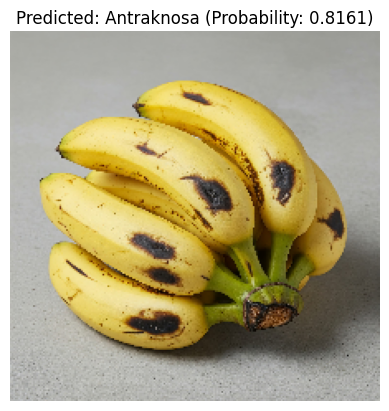

Predicted Label: Antraknosa
Prediction Probability: 0.8161
Predicting images using VGG16 FFE model...
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step


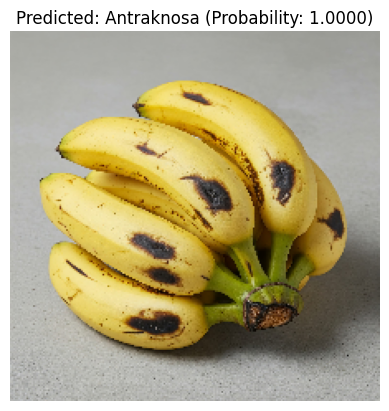

Predicted Label: Antraknosa
Prediction Probability: 1.0000


In [ ]:
def predict_image(model, img_path):
    # Memuat gambar
    img = image.load_img(img_path, target_size=(224, 224))  # Resize gambar sesuai dengan input model
    img_array = image.img_to_array(img)  # Mengubah gambar menjadi array numpy
    img_array = np.expand_dims(img_array, axis=0)  # Menambahkan batch dimension (model mengharapkan dimensi batch)
    img_array = img_array / 255.0  # Normalisasi piksel gambar ke rentang [0, 1]

    # Melakukan prediksi
    prediction_prob = model.predict(img_array)
    prediction = (prediction_prob > 0.5).astype(int).flatten()  # Menggunakan threshold 0.5 untuk klasifikasi biner

    # Menentukan label berdasarkan prediksi
    label = 'Sehat' if prediction == 0 else 'Antraknosa'
    probability = prediction_prob[0][0]

    return label, probability

# Mengunggah gambar
uploaded = files.upload()  # Memungkinkan pengguna mengunggah file
img_path = next(iter(uploaded))  # Mengambil nama file pertama dari yang diunggah

# Melakukan prediksi
for name, model in models.items():
  print(f"Predicting images using {name} model...")
  label, probability = predict_image(model, img_path)

  # Menampilkan gambar dan hasil prediksi
  img = image.load_img(img_path, target_size=(224, 224))  # Memuat gambar untuk ditampilkan
  plt.imshow(img)
  plt.axis('off')  # Menyembunyikan axis
  plt.title(f"Predicted: {label} (Probability: {probability:.4f})")
  plt.show()

  print(f"Predicted Label: {label}")
  print(f"Prediction Probability: {probability:.4f}")

Saving Gemini_Generated_Image_aci1d2aci1d2aci1.jpeg to Gemini_Generated_Image_aci1d2aci1d2aci1.jpeg
Predicting images using VGG16 FT model...
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step


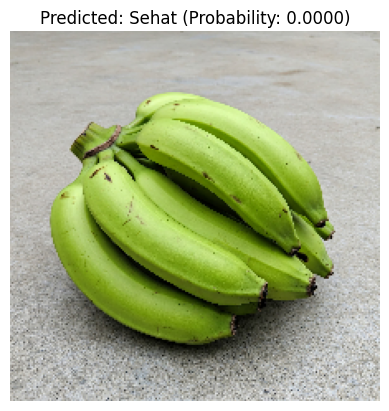

Predicted Label: Sehat
Prediction Probability: 0.0000
Predicting images using CNN model...
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 886ms/step


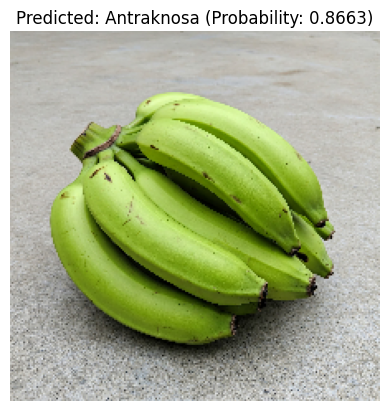

Predicted Label: Antraknosa
Prediction Probability: 0.8663
Predicting images using VGG16 FFE model...
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 621ms/step


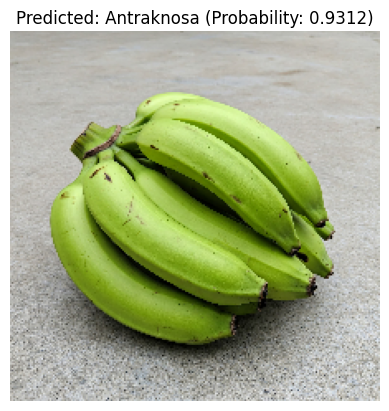

Predicted Label: Antraknosa
Prediction Probability: 0.9312


In [ ]:
def predict_image(model, img_path):
    # Memuat gambar
    img = image.load_img(img_path, target_size=(224, 224))  # Resize gambar sesuai dengan input model
    img_array = image.img_to_array(img)  # Mengubah gambar menjadi array numpy
    img_array = np.expand_dims(img_array, axis=0)  # Menambahkan batch dimension (model mengharapkan dimensi batch)
    img_array = img_array / 255.0  # Normalisasi piksel gambar ke rentang [0, 1]

    # Melakukan prediksi
    prediction_prob = model.predict(img_array)
    prediction = (prediction_prob > 0.5).astype(int).flatten()  # Menggunakan threshold 0.5 untuk klasifikasi biner

    # Menentukan label berdasarkan prediksi
    label = 'Sehat' if prediction == 0 else 'Antraknosa'
    probability = prediction_prob[0][0]

    return label, probability

# Mengunggah gambar
uploaded = files.upload()  # Memungkinkan pengguna mengunggah file
img_path = next(iter(uploaded))  # Mengambil nama file pertama dari yang diunggah

# Melakukan prediksi
for name, model in models.items():
  print(f"Predicting images using {name} model...")
  label, probability = predict_image(model, img_path)

  # Menampilkan gambar dan hasil prediksi
  img = image.load_img(img_path, target_size=(224, 224))  # Memuat gambar untuk ditampilkan
  plt.imshow(img)
  plt.axis('off')  # Menyembunyikan axis
  plt.title(f"Predicted: {label} (Probability: {probability:.4f})")
  plt.show()

  print(f"Predicted Label: {label}")
  print(f"Prediction Probability: {probability:.4f}")

Saving Gemini_Generated_Image_xttj5bxttj5bxttj.jpeg to Gemini_Generated_Image_xttj5bxttj5bxttj.jpeg
Predicting images using VGG16 FT model...
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step


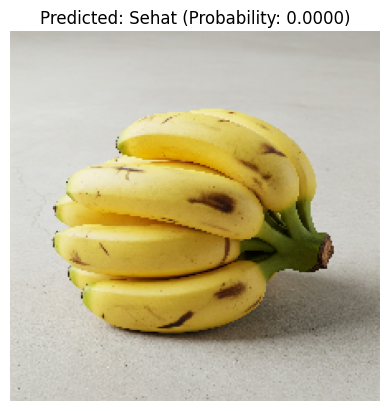

Predicted Label: Sehat
Prediction Probability: 0.0000
Predicting images using CNN model...
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step


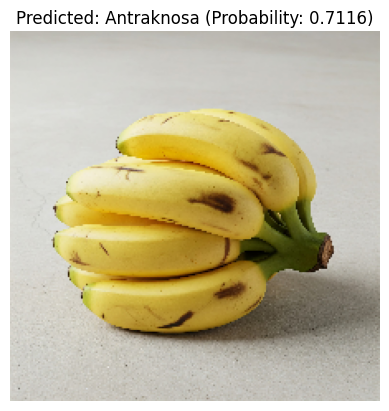

Predicted Label: Antraknosa
Prediction Probability: 0.7116
Predicting images using VGG16 FFE model...
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step


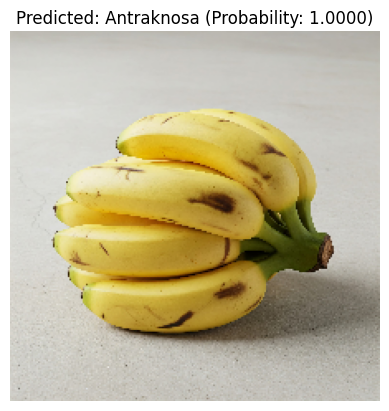

Predicted Label: Antraknosa
Prediction Probability: 1.0000


In [ ]:
def predict_image(model, img_path):
    # Memuat gambar
    img = image.load_img(img_path, target_size=(224, 224))  # Resize gambar sesuai dengan input model
    img_array = image.img_to_array(img)  # Mengubah gambar menjadi array numpy
    img_array = np.expand_dims(img_array, axis=0)  # Menambahkan batch dimension (model mengharapkan dimensi batch)
    img_array = img_array / 255.0  # Normalisasi piksel gambar ke rentang [0, 1]

    # Melakukan prediksi
    prediction_prob = model.predict(img_array)
    prediction = (prediction_prob > 0.5).astype(int).flatten()  # Menggunakan threshold 0.5 untuk klasifikasi biner

    # Menentukan label berdasarkan prediksi
    label = 'Sehat' if prediction == 0 else 'Antraknosa'
    probability = prediction_prob[0][0]

    return label, probability

# Mengunggah gambar
uploaded = files.upload()  # Memungkinkan pengguna mengunggah file
img_path = next(iter(uploaded))  # Mengambil nama file pertama dari yang diunggah

# Melakukan prediksi
for name, model in models.items():
  print(f"Predicting images using {name} model...")
  label, probability = predict_image(model, img_path)

  # Menampilkan gambar dan hasil prediksi
  img = image.load_img(img_path, target_size=(224, 224))  # Memuat gambar untuk ditampilkan
  plt.imshow(img)
  plt.axis('off')  # Menyembunyikan axis
  plt.title(f"Predicted: {label} (Probability: {probability:.4f})")
  plt.show()

  print(f"Predicted Label: {label}")
  print(f"Prediction Probability: {probability:.4f}")

Saving Gemini_Generated_Image_2mc2j32mc2j32mc2.jpeg to Gemini_Generated_Image_2mc2j32mc2j32mc2.jpeg
Predicting images using VGG16 FT model...
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step


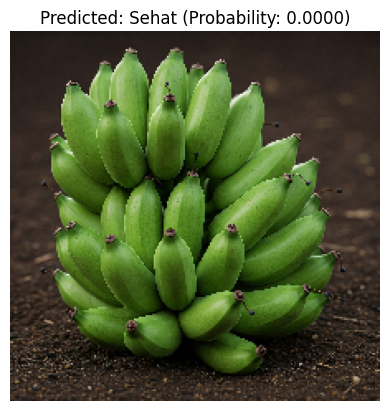

Predicted Label: Sehat
Prediction Probability: 0.0000
Predicting images using CNN model...
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step


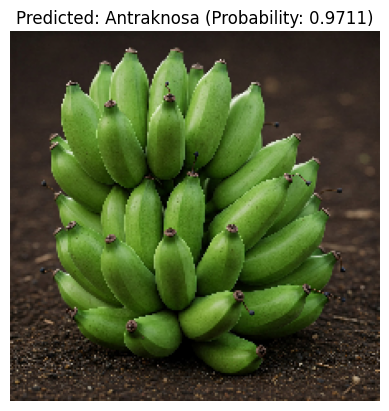

Predicted Label: Antraknosa
Prediction Probability: 0.9711
Predicting images using VGG16 FFE model...
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step


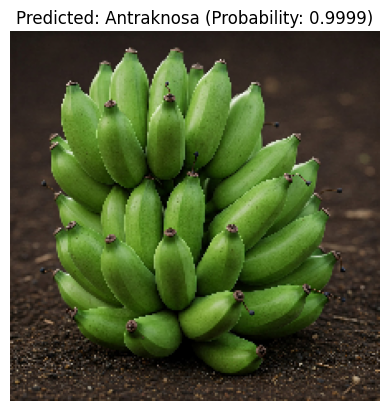

Predicted Label: Antraknosa
Prediction Probability: 0.9999


In [ ]:
def predict_image(model, img_path):
    # Memuat gambar
    img = image.load_img(img_path, target_size=(224, 224))  # Resize gambar sesuai dengan input model
    img_array = image.img_to_array(img)  # Mengubah gambar menjadi array numpy
    img_array = np.expand_dims(img_array, axis=0)  # Menambahkan batch dimension (model mengharapkan dimensi batch)
    img_array = img_array / 255.0  # Normalisasi piksel gambar ke rentang [0, 1]

    # Melakukan prediksi
    prediction_prob = model.predict(img_array)
    prediction = (prediction_prob > 0.5).astype(int).flatten()  # Menggunakan threshold 0.5 untuk klasifikasi biner

    # Menentukan label berdasarkan prediksi
    label = 'Sehat' if prediction == 0 else 'Antraknosa'
    probability = prediction_prob[0][0]

    return label, probability

# Mengunggah gambar
uploaded = files.upload()  # Memungkinkan pengguna mengunggah file
img_path = next(iter(uploaded))  # Mengambil nama file pertama dari yang diunggah

# Melakukan prediksi
for name, model in models.items():
  print(f"Predicting images using {name} model...")
  label, probability = predict_image(model, img_path)

  # Menampilkan gambar dan hasil prediksi
  img = image.load_img(img_path, target_size=(224, 224))  # Memuat gambar untuk ditampilkan
  plt.imshow(img)
  plt.axis('off')  # Menyembunyikan axis
  plt.title(f"Predicted: {label} (Probability: {probability:.4f})")
  plt.show()

  print(f"Predicted Label: {label}")
  print(f"Prediction Probability: {probability:.4f}")

Saving Gemini_Generated_Image_ua0t59ua0t59ua0t.jpeg to Gemini_Generated_Image_ua0t59ua0t59ua0t.jpeg
Predicting images using VGG16 FT model...
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step


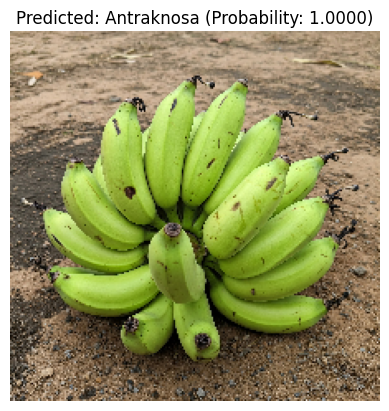

Predicted Label: Antraknosa
Prediction Probability: 1.0000
Predicting images using CNN model...
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step


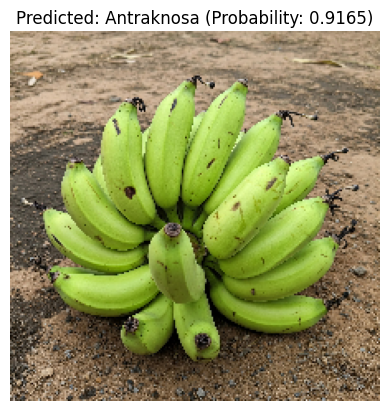

Predicted Label: Antraknosa
Prediction Probability: 0.9165
Predicting images using VGG16 FFE model...
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step


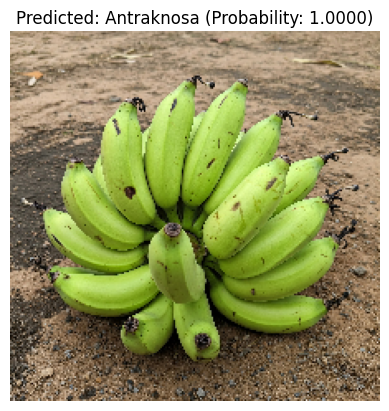

Predicted Label: Antraknosa
Prediction Probability: 1.0000


In [ ]:
def predict_image(model, img_path):
    # Memuat gambar
    img = image.load_img(img_path, target_size=(224, 224))  # Resize gambar sesuai dengan input model
    img_array = image.img_to_array(img)  # Mengubah gambar menjadi array numpy
    img_array = np.expand_dims(img_array, axis=0)  # Menambahkan batch dimension (model mengharapkan dimensi batch)
    img_array = img_array / 255.0  # Normalisasi piksel gambar ke rentang [0, 1]

    # Melakukan prediksi
    prediction_prob = model.predict(img_array)
    prediction = (prediction_prob > 0.5).astype(int).flatten()  # Menggunakan threshold 0.5 untuk klasifikasi biner

    # Menentukan label berdasarkan prediksi
    label = 'Sehat' if prediction == 0 else 'Antraknosa'
    probability = prediction_prob[0][0]

    return label, probability

# Mengunggah gambar
uploaded = files.upload()  # Memungkinkan pengguna mengunggah file
img_path = next(iter(uploaded))  # Mengambil nama file pertama dari yang diunggah

# Melakukan prediksi
for name, model in models.items():
  print(f"Predicting images using {name} model...")
  label, probability = predict_image(model, img_path)

  # Menampilkan gambar dan hasil prediksi
  img = image.load_img(img_path, target_size=(224, 224))  # Memuat gambar untuk ditampilkan
  plt.imshow(img)
  plt.axis('off')  # Menyembunyikan axis
  plt.title(f"Predicted: {label} (Probability: {probability:.4f})")
  plt.show()

  print(f"Predicted Label: {label}")
  print(f"Prediction Probability: {probability:.4f}")

Saving Gemini_Generated_Image_wvkroqwvkroqwvkr.jpeg to Gemini_Generated_Image_wvkroqwvkroqwvkr.jpeg
Predicting images using VGG16 FT model...
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


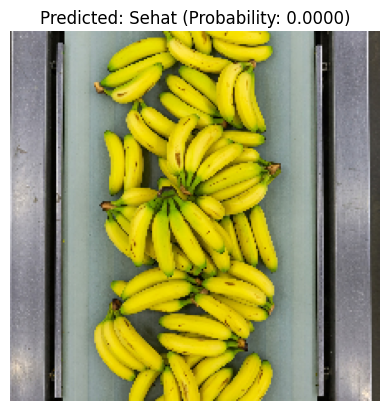

Predicted Label: Sehat
Prediction Probability: 0.0000
Predicting images using CNN model...
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


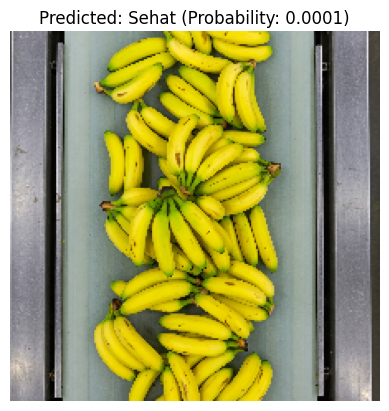

Predicted Label: Sehat
Prediction Probability: 0.0001
Predicting images using VGG16 FFE model...
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step


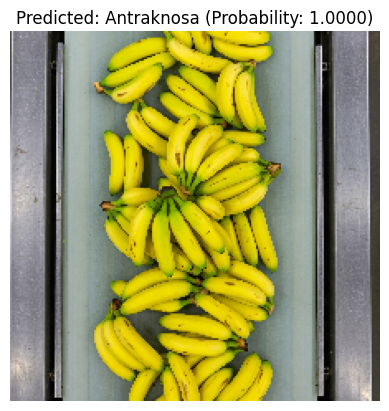

Predicted Label: Antraknosa
Prediction Probability: 1.0000


In [ ]:
def predict_image(model, img_path):
    # Memuat gambar
    img = image.load_img(img_path, target_size=(224, 224))  # Resize gambar sesuai dengan input model
    img_array = image.img_to_array(img)  # Mengubah gambar menjadi array numpy
    img_array = np.expand_dims(img_array, axis=0)  # Menambahkan batch dimension (model mengharapkan dimensi batch)
    img_array = img_array / 255.0  # Normalisasi piksel gambar ke rentang [0, 1]

    # Melakukan prediksi
    prediction_prob = model.predict(img_array)
    prediction = (prediction_prob > 0.5).astype(int).flatten()  # Menggunakan threshold 0.5 untuk klasifikasi biner

    # Menentukan label berdasarkan prediksi
    label = 'Sehat' if prediction == 0 else 'Antraknosa'
    probability = prediction_prob[0][0]

    return label, probability

# Mengunggah gambar
uploaded = files.upload()  # Memungkinkan pengguna mengunggah file
img_path = next(iter(uploaded))  # Mengambil nama file pertama dari yang diunggah

# Melakukan prediksi
for name, model in models.items():
  print(f"Predicting images using {name} model...")
  label, probability = predict_image(model, img_path)

  # Menampilkan gambar dan hasil prediksi
  img = image.load_img(img_path, target_size=(224, 224))  # Memuat gambar untuk ditampilkan
  plt.imshow(img)
  plt.axis('off')  # Menyembunyikan axis
  plt.title(f"Predicted: {label} (Probability: {probability:.4f})")
  plt.show()

  print(f"Predicted Label: {label}")
  print(f"Prediction Probability: {probability:.4f}")

Saving Gemini_Generated_Image_ndjxgmndjxgmndjx.jpeg to Gemini_Generated_Image_ndjxgmndjxgmndjx.jpeg
Predicting images using VGG16 FT model...
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step


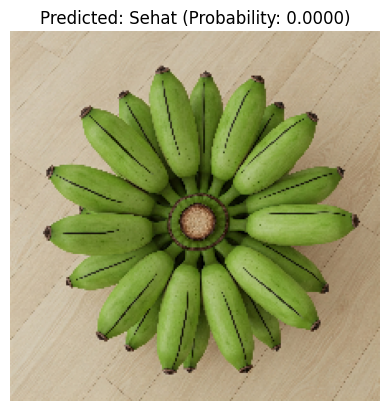

Predicted Label: Sehat
Prediction Probability: 0.0000
Predicting images using CNN model...
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step


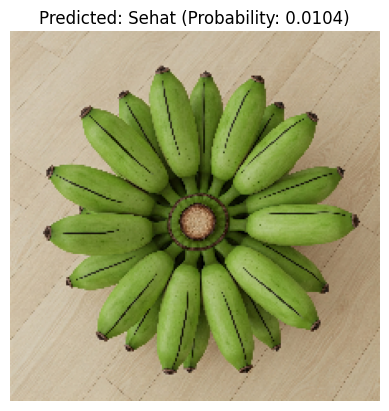

Predicted Label: Sehat
Prediction Probability: 0.0104
Predicting images using VGG16 FFE model...
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step


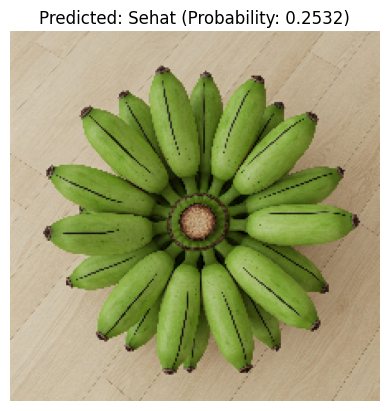

Predicted Label: Sehat
Prediction Probability: 0.2532


In [ ]:
def predict_image(model, img_path):
    # Memuat gambar
    img = image.load_img(img_path, target_size=(224, 224))  # Resize gambar sesuai dengan input model
    img_array = image.img_to_array(img)  # Mengubah gambar menjadi array numpy
    img_array = np.expand_dims(img_array, axis=0)  # Menambahkan batch dimension (model mengharapkan dimensi batch)
    img_array = img_array / 255.0  # Normalisasi piksel gambar ke rentang [0, 1]

    # Melakukan prediksi
    prediction_prob = model.predict(img_array)
    prediction = (prediction_prob > 0.5).astype(int).flatten()  # Menggunakan threshold 0.5 untuk klasifikasi biner

    # Menentukan label berdasarkan prediksi
    label = 'Sehat' if prediction == 0 else 'Antraknosa'
    probability = prediction_prob[0][0]

    return label, probability

# Mengunggah gambar
uploaded = files.upload()  # Memungkinkan pengguna mengunggah file
img_path = next(iter(uploaded))  # Mengambil nama file pertama dari yang diunggah

# Melakukan prediksi
for name, model in models.items():
  print(f"Predicting images using {name} model...")
  label, probability = predict_image(model, img_path)

  # Menampilkan gambar dan hasil prediksi
  img = image.load_img(img_path, target_size=(224, 224))  # Memuat gambar untuk ditampilkan
  plt.imshow(img)
  plt.axis('off')  # Menyembunyikan axis
  plt.title(f"Predicted: {label} (Probability: {probability:.4f})")
  plt.show()

  print(f"Predicted Label: {label}")
  print(f"Prediction Probability: {probability:.4f}")

Saving Gemini_Generated_Image_pkbmcfpkbmcfpkbm.jpeg to Gemini_Generated_Image_pkbmcfpkbmcfpkbm.jpeg
Predicting images using VGG16 FT model...
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step


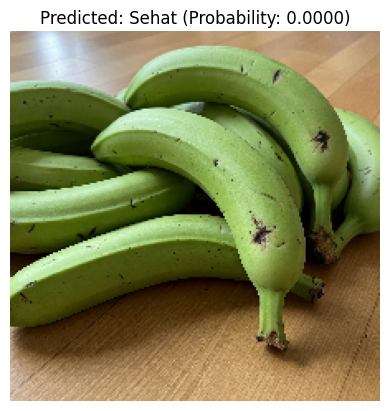

Predicted Label: Sehat
Prediction Probability: 0.0000
Predicting images using CNN model...
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step


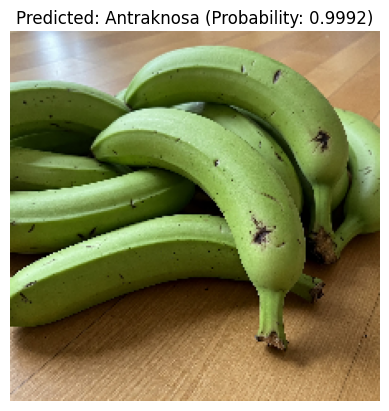

Predicted Label: Antraknosa
Prediction Probability: 0.9992
Predicting images using VGG16 FFE model...
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step


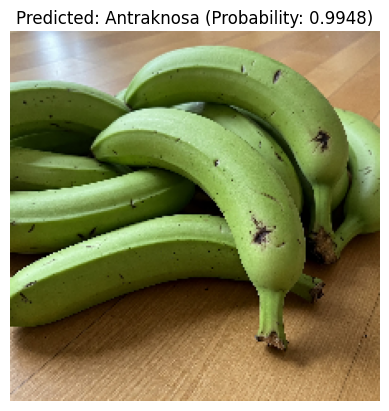

Predicted Label: Antraknosa
Prediction Probability: 0.9948


In [ ]:
def predict_image(model, img_path):
    # Memuat gambar
    img = image.load_img(img_path, target_size=(224, 224))  # Resize gambar sesuai dengan input model
    img_array = image.img_to_array(img)  # Mengubah gambar menjadi array numpy
    img_array = np.expand_dims(img_array, axis=0)  # Menambahkan batch dimension (model mengharapkan dimensi batch)
    img_array = img_array / 255.0  # Normalisasi piksel gambar ke rentang [0, 1]

    # Melakukan prediksi
    prediction_prob = model.predict(img_array)
    prediction = (prediction_prob > 0.5).astype(int).flatten()  # Menggunakan threshold 0.5 untuk klasifikasi biner

    # Menentukan label berdasarkan prediksi
    label = 'Sehat' if prediction == 0 else 'Antraknosa'
    probability = prediction_prob[0][0]

    return label, probability

# Mengunggah gambar
uploaded = files.upload()  # Memungkinkan pengguna mengunggah file
img_path = next(iter(uploaded))  # Mengambil nama file pertama dari yang diunggah

# Melakukan prediksi
for name, model in models.items():
  print(f"Predicting images using {name} model...")
  label, probability = predict_image(model, img_path)

  # Menampilkan gambar dan hasil prediksi
  img = image.load_img(img_path, target_size=(224, 224))  # Memuat gambar untuk ditampilkan
  plt.imshow(img)
  plt.axis('off')  # Menyembunyikan axis
  plt.title(f"Predicted: {label} (Probability: {probability:.4f})")
  plt.show()

  print(f"Predicted Label: {label}")
  print(f"Prediction Probability: {probability:.4f}")


Saving Gemini_Generated_Image_ktzpl9ktzpl9ktzp.jpeg to Gemini_Generated_Image_ktzpl9ktzpl9ktzp.jpeg
Predicting images using VGG16 FT model...
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step


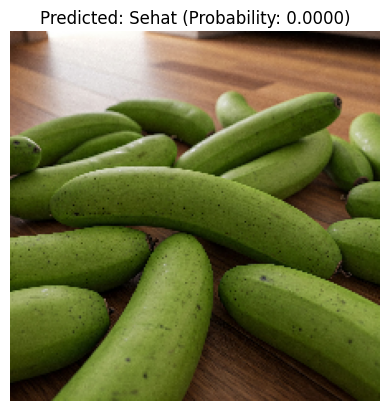

Predicted Label: Sehat
Prediction Probability: 0.0000
Predicting images using CNN model...
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


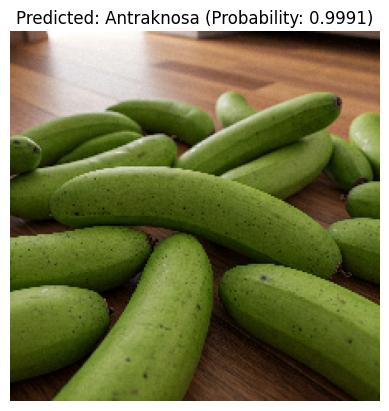

Predicted Label: Antraknosa
Prediction Probability: 0.9991
Predicting images using VGG16 FFE model...
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step


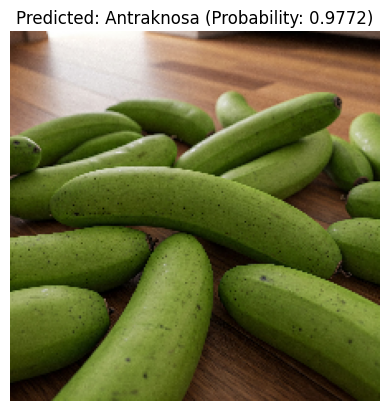

Predicted Label: Antraknosa
Prediction Probability: 0.9772


In [ ]:
def predict_image(model, img_path):
    # Memuat gambar
    img = image.load_img(img_path, target_size=(224, 224))  # Resize gambar sesuai dengan input model
    img_array = image.img_to_array(img)  # Mengubah gambar menjadi array numpy
    img_array = np.expand_dims(img_array, axis=0)  # Menambahkan batch dimension (model mengharapkan dimensi batch)
    img_array = img_array / 255.0  # Normalisasi piksel gambar ke rentang [0, 1]

    # Melakukan prediksi
    prediction_prob = model.predict(img_array)
    prediction = (prediction_prob > 0.5).astype(int).flatten()  # Menggunakan threshold 0.5 untuk klasifikasi biner

    # Menentukan label berdasarkan prediksi
    label = 'Sehat' if prediction == 0 else 'Antraknosa'
    probability = prediction_prob[0][0]

    return label, probability

# Mengunggah gambar
uploaded = files.upload()  # Memungkinkan pengguna mengunggah file
img_path = next(iter(uploaded))  # Mengambil nama file pertama dari yang diunggah

# Melakukan prediksi
for name, model in models.items():
  print(f"Predicting images using {name} model...")
  label, probability = predict_image(model, img_path)

  # Menampilkan gambar dan hasil prediksi
  img = image.load_img(img_path, target_size=(224, 224))  # Memuat gambar untuk ditampilkan
  plt.imshow(img)
  plt.axis('off')  # Menyembunyikan axis
  plt.title(f"Predicted: {label} (Probability: {probability:.4f})")
  plt.show()

  print(f"Predicted Label: {label}")
  print(f"Prediction Probability: {probability:.4f}")

Saving Gemini_Generated_Image_hy4uzihy4uzihy4u.jpeg to Gemini_Generated_Image_hy4uzihy4uzihy4u.jpeg
Predicting images using VGG16 FT model...
1/1 ━━━━━━━━━━━━━━━━━━━━ 4s 4s/step


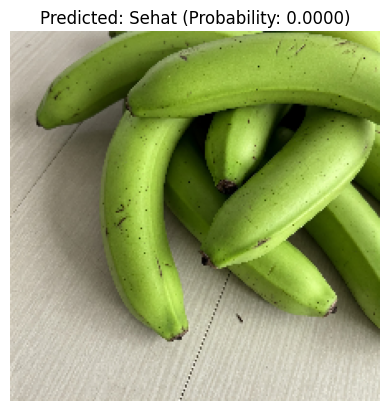

Predicted Label: Sehat
Prediction Probability: 0.0000
Predicting images using CNN model...
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 943ms/step


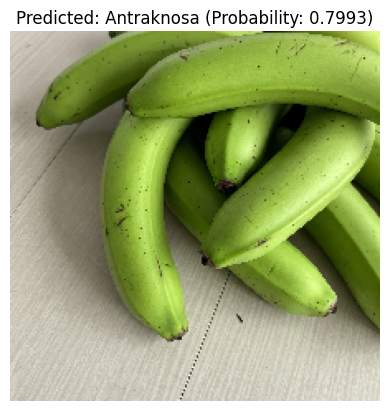

Predicted Label: Antraknosa
Prediction Probability: 0.7993
Predicting images using VGG16 FFE model...
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 611ms/step


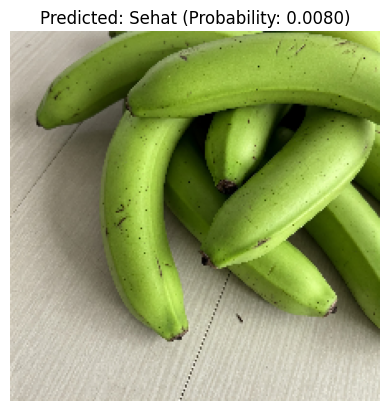

Predicted Label: Sehat
Prediction Probability: 0.0080


In [ ]:
def predict_image(model, img_path):
    # Memuat gambar
    img = image.load_img(img_path, target_size=(224, 224))  # Resize gambar sesuai dengan input model
    img_array = image.img_to_array(img)  # Mengubah gambar menjadi array numpy
    img_array = np.expand_dims(img_array, axis=0)  # Menambahkan batch dimension (model mengharapkan dimensi batch)
    img_array = img_array / 255.0  # Normalisasi piksel gambar ke rentang [0, 1]

    # Melakukan prediksi
    prediction_prob = model.predict(img_array)
    prediction = (prediction_prob > 0.5).astype(int).flatten()  # Menggunakan threshold 0.5 untuk klasifikasi biner

    # Menentukan label berdasarkan prediksi
    label = 'Sehat' if prediction == 0 else 'Antraknosa'
    probability = prediction_prob[0][0]

    return label, probability

# Mengunggah gambar
uploaded = files.upload()  # Memungkinkan pengguna mengunggah file
img_path = next(iter(uploaded))  # Mengambil nama file pertama dari yang diunggah

# Melakukan prediksi
for name, model in models.items():
  print(f"Predicting images using {name} model...")
  label, probability = predict_image(model, img_path)

  # Menampilkan gambar dan hasil prediksi
  img = image.load_img(img_path, target_size=(224, 224))  # Memuat gambar untuk ditampilkan
  plt.imshow(img)
  plt.axis('off')  # Menyembunyikan axis
  plt.title(f"Predicted: {label} (Probability: {probability:.4f})")
  plt.show()

  print(f"Predicted Label: {label}")
  print(f"Prediction Probability: {probability:.4f}")

Saving Gemini_Generated_Image_ur1rcfur1rcfur1r.jpeg to Gemini_Generated_Image_ur1rcfur1rcfur1r.jpeg
Predicting images using VGG16 FT model...
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step


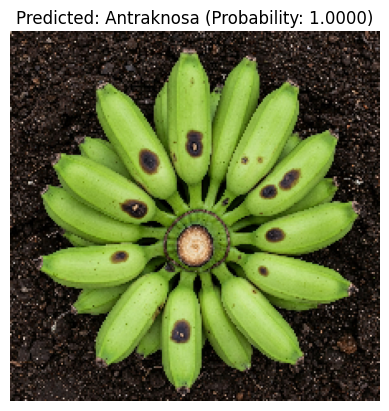

Predicted Label: Antraknosa
Prediction Probability: 1.0000
Predicting images using CNN model...
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step


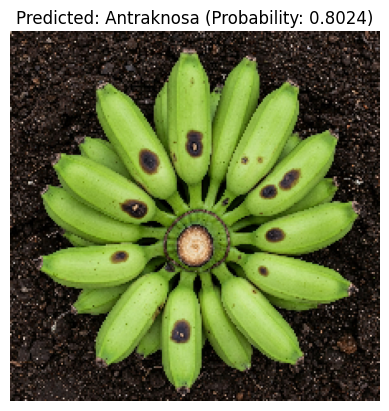

Predicted Label: Antraknosa
Prediction Probability: 0.8024
Predicting images using VGG16 FFE model...
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step


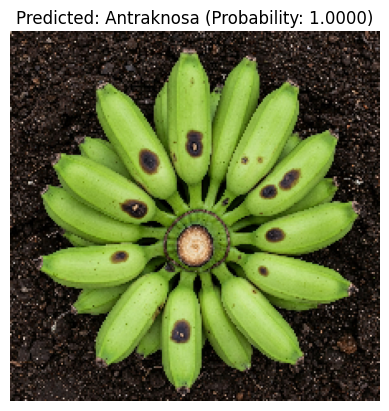

Predicted Label: Antraknosa
Prediction Probability: 1.0000


In [ ]:
def predict_image(model, img_path):
    # Memuat gambar
    img = image.load_img(img_path, target_size=(224, 224))  # Resize gambar sesuai dengan input model
    img_array = image.img_to_array(img)  # Mengubah gambar menjadi array numpy
    img_array = np.expand_dims(img_array, axis=0)  # Menambahkan batch dimension (model mengharapkan dimensi batch)
    img_array = img_array / 255.0  # Normalisasi piksel gambar ke rentang [0, 1]

    # Melakukan prediksi
    prediction_prob = model.predict(img_array)
    prediction = (prediction_prob > 0.5).astype(int).flatten()  # Menggunakan threshold 0.5 untuk klasifikasi biner

    # Menentukan label berdasarkan prediksi
    label = 'Sehat' if prediction == 0 else 'Antraknosa'
    probability = prediction_prob[0][0]

    return label, probability

# Mengunggah gambar
uploaded = files.upload()  # Memungkinkan pengguna mengunggah file
img_path = next(iter(uploaded))  # Mengambil nama file pertama dari yang diunggah

# Melakukan prediksi
for name, model in models.items():
  print(f"Predicting images using {name} model...")
  label, probability = predict_image(model, img_path)

  # Menampilkan gambar dan hasil prediksi
  img = image.load_img(img_path, target_size=(224, 224))  # Memuat gambar untuk ditampilkan
  plt.imshow(img)
  plt.axis('off')  # Menyembunyikan axis
  plt.title(f"Predicted: {label} (Probability: {probability:.4f})")
  plt.show()

  print(f"Predicted Label: {label}")
  print(f"Prediction Probability: {probability:.4f}")

Saving Gemini_Generated_Image_z4e0vnz4e0vnz4e0.jpeg to Gemini_Generated_Image_z4e0vnz4e0vnz4e0.jpeg
Predicting images using VGG16 FT model...
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step


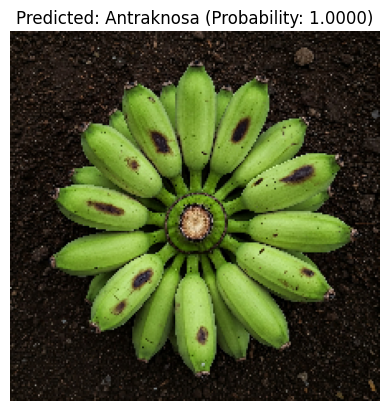

Predicted Label: Antraknosa
Prediction Probability: 1.0000
Predicting images using CNN model...
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step


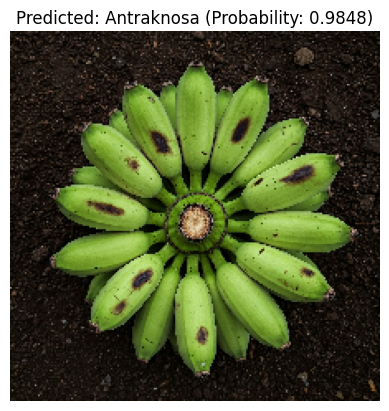

Predicted Label: Antraknosa
Prediction Probability: 0.9848
Predicting images using VGG16 FFE model...
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step


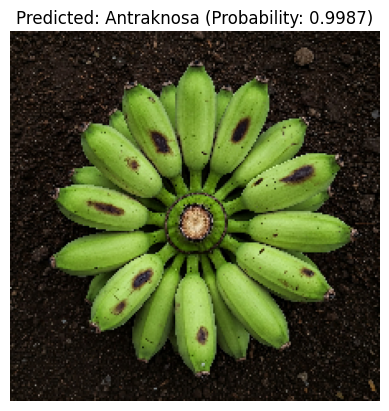

Predicted Label: Antraknosa
Prediction Probability: 0.9987


In [ ]:
def predict_image(model, img_path):
    # Memuat gambar
    img = image.load_img(img_path, target_size=(224, 224))  # Resize gambar sesuai dengan input model
    img_array = image.img_to_array(img)  # Mengubah gambar menjadi array numpy
    img_array = np.expand_dims(img_array, axis=0)  # Menambahkan batch dimension (model mengharapkan dimensi batch)
    img_array = img_array / 255.0  # Normalisasi piksel gambar ke rentang [0, 1]

    # Melakukan prediksi
    prediction_prob = model.predict(img_array)
    prediction = (prediction_prob > 0.5).astype(int).flatten()  # Menggunakan threshold 0.5 untuk klasifikasi biner

    # Menentukan label berdasarkan prediksi
    label = 'Sehat' if prediction == 0 else 'Antraknosa'
    probability = prediction_prob[0][0]

    return label, probability

# Mengunggah gambar
uploaded = files.upload()  # Memungkinkan pengguna mengunggah file
img_path = next(iter(uploaded))  # Mengambil nama file pertama dari yang diunggah

# Melakukan prediksi
for name, model in models.items():
  print(f"Predicting images using {name} model...")
  label, probability = predict_image(model, img_path)

  # Menampilkan gambar dan hasil prediksi
  img = image.load_img(img_path, target_size=(224, 224))  # Memuat gambar untuk ditampilkan
  plt.imshow(img)
  plt.axis('off')  # Menyembunyikan axis
  plt.title(f"Predicted: {label} (Probability: {probability:.4f})")
  plt.show()

  print(f"Predicted Label: {label}")
  print(f"Prediction Probability: {probability:.4f}")

Saving b0386acdce9d24cbce50cca91a9b1e65.jpeg to b0386acdce9d24cbce50cca91a9b1e65.jpeg
Predicting images using VGG16 FT model...
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step


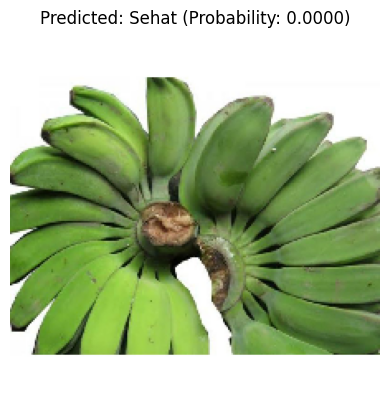

Predicted Label: Sehat
Prediction Probability: 0.0000
Predicting images using CNN model...
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step


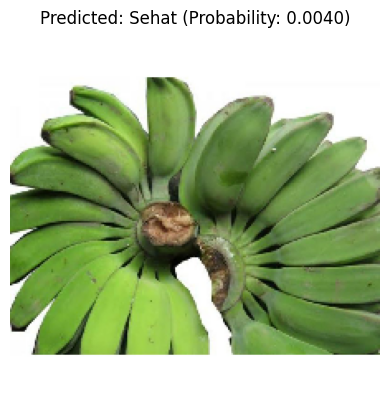

Predicted Label: Sehat
Prediction Probability: 0.0040
Predicting images using VGG16 FFE model...
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


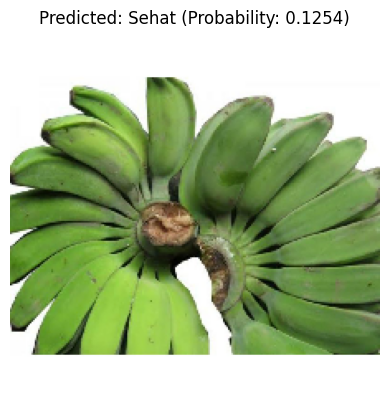

Predicted Label: Sehat
Prediction Probability: 0.1254


In [ ]:
def predict_image(model, img_path):
    # Memuat gambar
    img = image.load_img(img_path, target_size=(224, 224))  # Resize gambar sesuai dengan input model
    img_array = image.img_to_array(img)  # Mengubah gambar menjadi array numpy
    img_array = np.expand_dims(img_array, axis=0)  # Menambahkan batch dimension (model mengharapkan dimensi batch)
    img_array = img_array / 255.0  # Normalisasi piksel gambar ke rentang [0, 1]

    # Melakukan prediksi
    prediction_prob = model.predict(img_array)
    prediction = (prediction_prob > 0.5).astype(int).flatten()  # Menggunakan threshold 0.5 untuk klasifikasi biner

    # Menentukan label berdasarkan prediksi
    label = 'Sehat' if prediction == 0 else 'Antraknosa'
    probability = prediction_prob[0][0]

    return label, probability

# Mengunggah gambar
uploaded = files.upload()  # Memungkinkan pengguna mengunggah file
img_path = next(iter(uploaded))  # Mengambil nama file pertama dari yang diunggah

# Melakukan prediksi
for name, model in models.items():
  print(f"Predicting images using {name} model...")
  label, probability = predict_image(model, img_path)

  # Menampilkan gambar dan hasil prediksi
  img = image.load_img(img_path, target_size=(224, 224))  # Memuat gambar untuk ditampilkan
  plt.imshow(img)
  plt.axis('off')  # Menyembunyikan axis
  plt.title(f"Predicted: {label} (Probability: {probability:.4f})")
  plt.show()

  print(f"Predicted Label: {label}")
  print(f"Prediction Probability: {probability:.4f}")

Saving Gemini_Generated_Image_hy4uzihy4uzihy4u.jpeg to Gemini_Generated_Image_hy4uzihy4uzihy4u.jpeg
Predicting images using VGG16 FT model...
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step


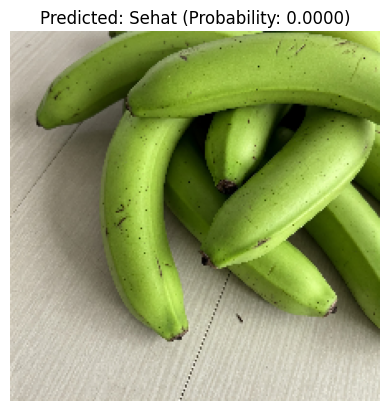

Predicted Label: Sehat
Prediction Probability: 0.0000
Predicting images using CNN model...
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step


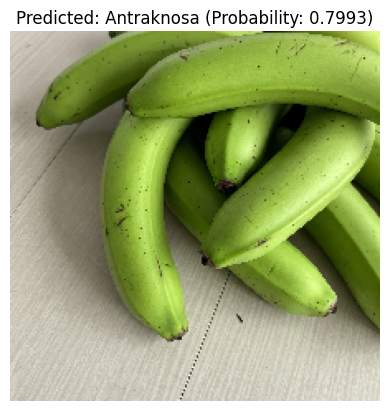

Predicted Label: Antraknosa
Prediction Probability: 0.7993
Predicting images using VGG16 FFE model...
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step


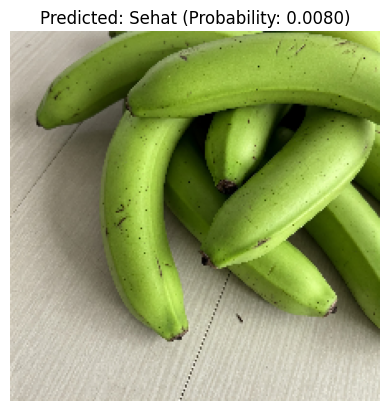

Predicted Label: Sehat
Prediction Probability: 0.0080


In [ ]:
def predict_image(model, img_path):
    # Memuat gambar
    img = image.load_img(img_path, target_size=(224, 224))  # Resize gambar sesuai dengan input model
    img_array = image.img_to_array(img)  # Mengubah gambar menjadi array numpy
    img_array = np.expand_dims(img_array, axis=0)  # Menambahkan batch dimension (model mengharapkan dimensi batch)
    img_array = img_array / 255.0  # Normalisasi piksel gambar ke rentang [0, 1]

    # Melakukan prediksi
    prediction_prob = model.predict(img_array)
    prediction = (prediction_prob > 0.5).astype(int).flatten()  # Menggunakan threshold 0.5 untuk klasifikasi biner

    # Menentukan label berdasarkan prediksi
    label = 'Sehat' if prediction == 0 else 'Antraknosa'
    probability = prediction_prob[0][0]

    return label, probability

# Mengunggah gambar
uploaded = files.upload()  # Memungkinkan pengguna mengunggah file
img_path = next(iter(uploaded))  # Mengambil nama file pertama dari yang diunggah

# Melakukan prediksi
for name, model in models.items():
  print(f"Predicting images using {name} model...")
  label, probability = predict_image(model, img_path)

  # Menampilkan gambar dan hasil prediksi
  img = image.load_img(img_path, target_size=(224, 224))  # Memuat gambar untuk ditampilkan
  plt.imshow(img)
  plt.axis('off')  # Menyembunyikan axis
  plt.title(f"Predicted: {label} (Probability: {probability:.4f})")
  plt.show()

  print(f"Predicted Label: {label}")
  print(f"Prediction Probability: {probability:.4f}")

Saving musa-acuminata-banana-de37a990-394a-11ec-97b8-d8c4975e38aa_jpg.rf.c3117a0123f6c080e81be78adbe8be73.jpg to musa-acuminata-banana-de37a990-394a-11ec-97b8-d8c4975e38aa_jpg.rf.c3117a0123f6c080e81be78adbe8be73.jpg
Predicting images using VGG16 FT model...
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step


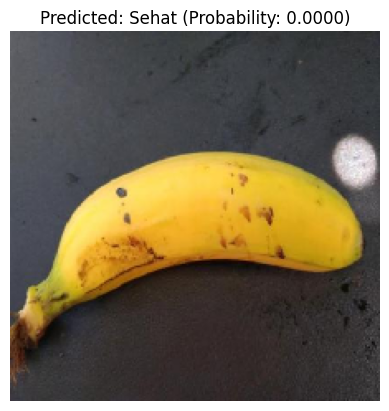

Predicted Label: Sehat
Prediction Probability: 0.0000
Predicting images using CNN model...
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


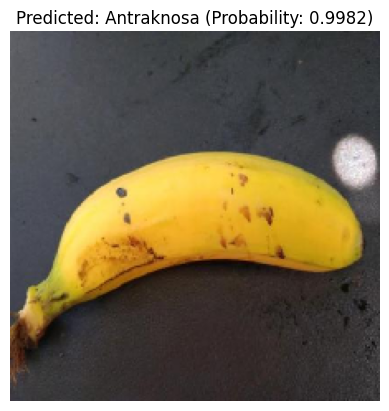

Predicted Label: Antraknosa
Prediction Probability: 0.9982
Predicting images using VGG16 FFE model...
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 832ms/step


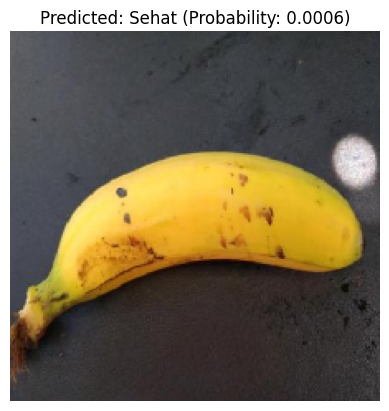

Predicted Label: Sehat
Prediction Probability: 0.0006


In [ ]:
def predict_image(model, img_path):
    # Memuat gambar
    img = image.load_img(img_path, target_size=(224, 224))  # Resize gambar sesuai dengan input model
    img_array = image.img_to_array(img)  # Mengubah gambar menjadi array numpy
    img_array = np.expand_dims(img_array, axis=0)  # Menambahkan batch dimension (model mengharapkan dimensi batch)
    img_array = img_array / 255.0  # Normalisasi piksel gambar ke rentang [0, 1]

    # Melakukan prediksi
    prediction_prob = model.predict(img_array)
    prediction = (prediction_prob > 0.5).astype(int).flatten()  # Menggunakan threshold 0.5 untuk klasifikasi biner

    # Menentukan label berdasarkan prediksi
    label = 'Sehat' if prediction == 0 else 'Antraknosa'
    probability = prediction_prob[0][0]

    return label, probability

# Mengunggah gambar
uploaded = files.upload()  # Memungkinkan pengguna mengunggah file
img_path = next(iter(uploaded))  # Mengambil nama file pertama dari yang diunggah

# Melakukan prediksi
for name, model in models.items():
  print(f"Predicting images using {name} model...")
  label, probability = predict_image(model, img_path)

  # Menampilkan gambar dan hasil prediksi
  img = image.load_img(img_path, target_size=(224, 224))  # Memuat gambar untuk ditampilkan
  plt.imshow(img)
  plt.axis('off')  # Menyembunyikan axis
  plt.title(f"Predicted: {label} (Probability: {probability:.4f})")
  plt.show()

  print(f"Predicted Label: {label}")
  print(f"Prediction Probability: {probability:.4f}")

Saving b99e7873-762c-4ad7-9f7b-10454862be5e.jpg to b99e7873-762c-4ad7-9f7b-10454862be5e.jpg
Predicting images using VGG16 FT model...
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step


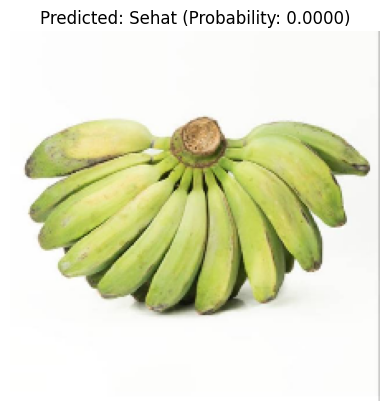

Predicted Label: Sehat
Prediction Probability: 0.0000
Predicting images using CNN model...
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step


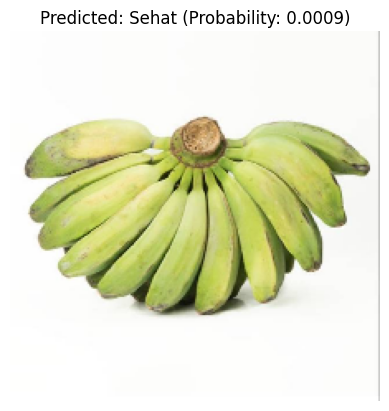

Predicted Label: Sehat
Prediction Probability: 0.0009
Predicting images using VGG16 FFE model...
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step


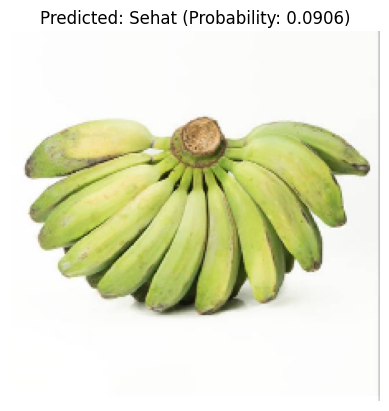

Predicted Label: Sehat
Prediction Probability: 0.0906


In [ ]:
def predict_image(model, img_path):
    # Memuat gambar
    img = image.load_img(img_path, target_size=(224, 224))  # Resize gambar sesuai dengan input model
    img_array = image.img_to_array(img)  # Mengubah gambar menjadi array numpy
    img_array = np.expand_dims(img_array, axis=0)  # Menambahkan batch dimension (model mengharapkan dimensi batch)
    img_array = img_array / 255.0  # Normalisasi piksel gambar ke rentang [0, 1]

    # Melakukan prediksi
    prediction_prob = model.predict(img_array)
    prediction = (prediction_prob > 0.5).astype(int).flatten()  # Menggunakan threshold 0.5 untuk klasifikasi biner

    # Menentukan label berdasarkan prediksi
    label = 'Sehat' if prediction == 0 else 'Antraknosa'
    probability = prediction_prob[0][0]

    return label, probability

# Mengunggah gambar
uploaded = files.upload()  # Memungkinkan pengguna mengunggah file
img_path = next(iter(uploaded))  # Mengambil nama file pertama dari yang diunggah

# Melakukan prediksi
for name, model in models.items():
  print(f"Predicting images using {name} model...")
  label, probability = predict_image(model, img_path)

  # Menampilkan gambar dan hasil prediksi
  img = image.load_img(img_path, target_size=(224, 224))  # Memuat gambar untuk ditampilkan
  plt.imshow(img)
  plt.axis('off')  # Menyembunyikan axis
  plt.title(f"Predicted: {label} (Probability: {probability:.4f})")
  plt.show()

  print(f"Predicted Label: {label}")
  print(f"Prediction Probability: {probability:.4f}")

Saving Pisang-mas-siap-kirim.-300x200.jpg to Pisang-mas-siap-kirim.-300x200.jpg
Predicting images using VGG16 FT model...
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step


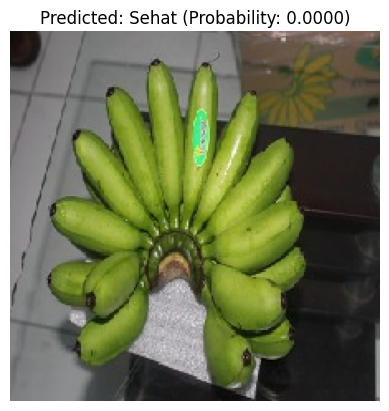

Predicted Label: Sehat
Prediction Probability: 0.0000
Predicting images using CNN model...
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step


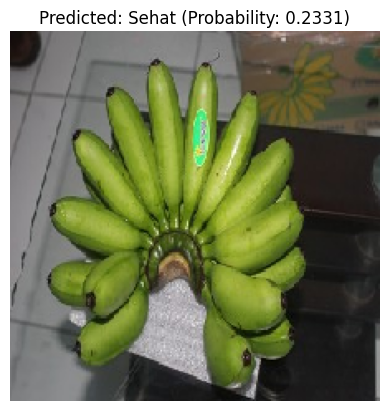

Predicted Label: Sehat
Prediction Probability: 0.2331
Predicting images using VGG16 FFE model...
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step


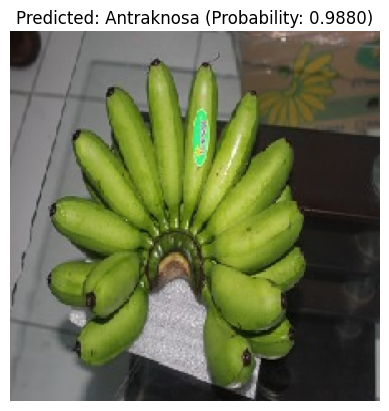

Predicted Label: Antraknosa
Prediction Probability: 0.9880


In [ ]:
def predict_image(model, img_path):
    # Memuat gambar
    img = image.load_img(img_path, target_size=(224, 224))  # Resize gambar sesuai dengan input model
    img_array = image.img_to_array(img)  # Mengubah gambar menjadi array numpy
    img_array = np.expand_dims(img_array, axis=0)  # Menambahkan batch dimension (model mengharapkan dimensi batch)
    img_array = img_array / 255.0  # Normalisasi piksel gambar ke rentang [0, 1]

    # Melakukan prediksi
    prediction_prob = model.predict(img_array)
    prediction = (prediction_prob > 0.5).astype(int).flatten()  # Menggunakan threshold 0.5 untuk klasifikasi biner

    # Menentukan label berdasarkan prediksi
    label = 'Sehat' if prediction == 0 else 'Antraknosa'
    probability = prediction_prob[0][0]

    return label, probability

# Mengunggah gambar
uploaded = files.upload()  # Memungkinkan pengguna mengunggah file
img_path = next(iter(uploaded))  # Mengambil nama file pertama dari yang diunggah

# Melakukan prediksi
for name, model in models.items():
  print(f"Predicting images using {name} model...")
  label, probability = predict_image(model, img_path)

  # Menampilkan gambar dan hasil prediksi
  img = image.load_img(img_path, target_size=(224, 224))  # Memuat gambar untuk ditampilkan
  plt.imshow(img)
  plt.axis('off')  # Menyembunyikan axis
  plt.title(f"Predicted: {label} (Probability: {probability:.4f})")
  plt.show()

  print(f"Predicted Label: {label}")
  print(f"Prediction Probability: {probability:.4f}")

Saving S6e4b987a8c044f7399ccabb87460c1aaH.jpg_720x720q80.jpg to S6e4b987a8c044f7399ccabb87460c1aaH.jpg_720x720q80.jpg
Predicting images using CNN model...
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step


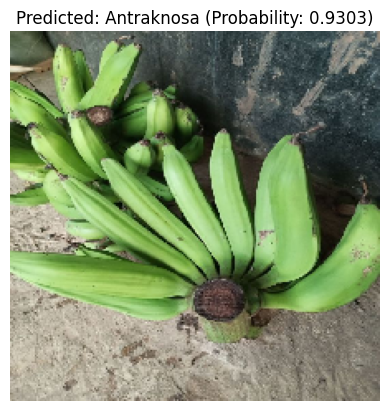

Predicted Label: Antraknosa
Prediction Probability: 0.9303
Predicting images using VGG16 FT model...
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step


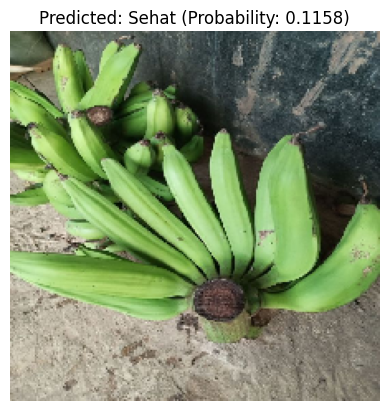

Predicted Label: Sehat
Prediction Probability: 0.1158
Predicting images using VGG16 FFE model...
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step


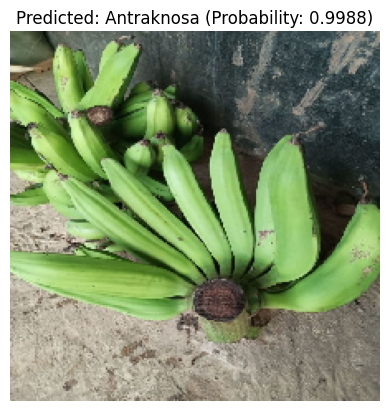

Predicted Label: Antraknosa
Prediction Probability: 0.9988


In [ ]:
def predict_image(model, img_path):
    # Memuat gambar
    img = image.load_img(img_path, target_size=(224, 224))  # Resize gambar sesuai dengan input model
    img_array = image.img_to_array(img)  # Mengubah gambar menjadi array numpy
    img_array = np.expand_dims(img_array, axis=0)  # Menambahkan batch dimension (model mengharapkan dimensi batch)
    img_array = img_array / 255.0  # Normalisasi piksel gambar ke rentang [0, 1]

    # Melakukan prediksi
    prediction_prob = model.predict(img_array)
    prediction = (prediction_prob > 0.5).astype(int).flatten()  # Menggunakan threshold 0.5 untuk klasifikasi biner

    # Menentukan label berdasarkan prediksi
    label = 'Sehat' if prediction == 0 else 'Antraknosa'
    probability = prediction_prob[0][0]

    return label, probability

# Mengunggah gambar
uploaded = files.upload()  # Memungkinkan pengguna mengunggah file
img_path = next(iter(uploaded))  # Mengambil nama file pertama dari yang diunggah

# Melakukan prediksi
for name, model in models.items():
  print(f"Predicting images using {name} model...")
  label, probability = predict_image(model, img_path)

  # Menampilkan gambar dan hasil prediksi
  img = image.load_img(img_path, target_size=(224, 224))  # Memuat gambar untuk ditampilkan
  plt.imshow(img)
  plt.axis('off')  # Menyembunyikan axis
  plt.title(f"Predicted: {label} (Probability: {probability:.4f})")
  plt.show()

  print(f"Predicted Label: {label}")
  print(f"Prediction Probability: {probability:.4f}")

Saving IMG-20220424-WA0021.jpg to IMG-20220424-WA0021.jpg
Predicting images using VGG16 FT model...
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step


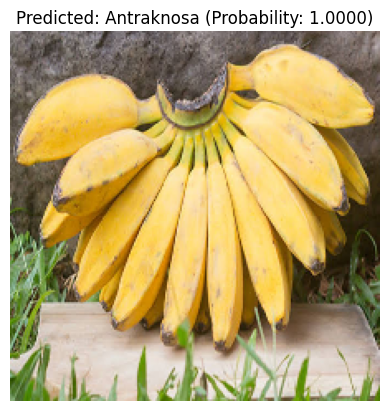

Predicted Label: Antraknosa
Prediction Probability: 1.0000
Predicting images using CNN model...
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step


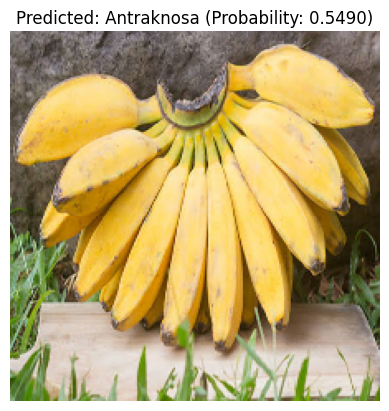

Predicted Label: Antraknosa
Prediction Probability: 0.5490
Predicting images using VGG16 FFE model...
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step


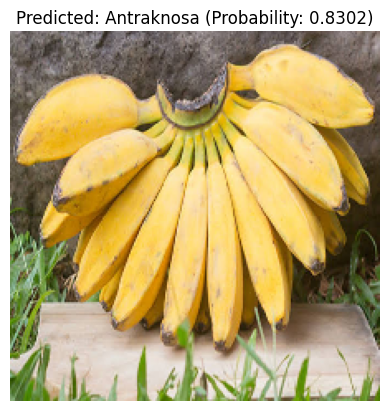

Predicted Label: Antraknosa
Prediction Probability: 0.8302


In [ ]:
def predict_image(model, img_path):
    # Memuat gambar
    img = image.load_img(img_path, target_size=(224, 224))  # Resize gambar sesuai dengan input model
    img_array = image.img_to_array(img)  # Mengubah gambar menjadi array numpy
    img_array = np.expand_dims(img_array, axis=0)  # Menambahkan batch dimension (model mengharapkan dimensi batch)
    img_array = img_array / 255.0  # Normalisasi piksel gambar ke rentang [0, 1]

    # Melakukan prediksi
    prediction_prob = model.predict(img_array)
    prediction = (prediction_prob > 0.5).astype(int).flatten()  # Menggunakan threshold 0.5 untuk klasifikasi biner

    # Menentukan label berdasarkan prediksi
    label = 'Sehat' if prediction == 0 else 'Antraknosa'
    probability = prediction_prob[0][0]

    return label, probability

# Mengunggah gambar
uploaded = files.upload()  # Memungkinkan pengguna mengunggah file
img_path = next(iter(uploaded))  # Mengambil nama file pertama dari yang diunggah

# Melakukan prediksi
for name, model in models.items():
  print(f"Predicting images using {name} model...")
  label, probability = predict_image(model, img_path)

  # Menampilkan gambar dan hasil prediksi
  img = image.load_img(img_path, target_size=(224, 224))  # Memuat gambar untuk ditampilkan
  plt.imshow(img)
  plt.axis('off')  # Menyembunyikan axis
  plt.title(f"Predicted: {label} (Probability: {probability:.4f})")
  plt.show()

  print(f"Predicted Label: {label}")
  print(f"Prediction Probability: {probability:.4f}")

Saving images (4).jpeg to images (4).jpeg
Predicting images using VGG16 FT model...
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


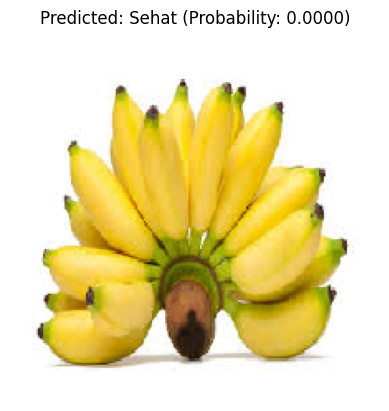

Predicted Label: Sehat
Prediction Probability: 0.0000
Predicting images using CNN model...
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


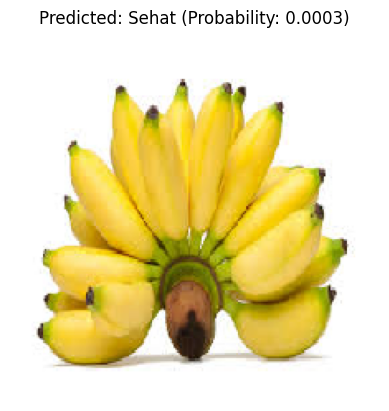

Predicted Label: Sehat
Prediction Probability: 0.0003
Predicting images using VGG16 FFE model...
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


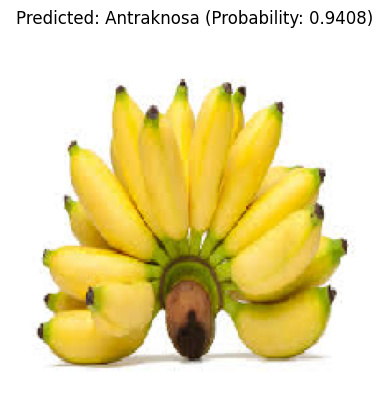

Predicted Label: Antraknosa
Prediction Probability: 0.9408


In [ ]:
def predict_image(model, img_path):
    # Memuat gambar
    img = image.load_img(img_path, target_size=(224, 224))  # Resize gambar sesuai dengan input model
    img_array = image.img_to_array(img)  # Mengubah gambar menjadi array numpy
    img_array = np.expand_dims(img_array, axis=0)  # Menambahkan batch dimension (model mengharapkan dimensi batch)
    img_array = img_array / 255.0  # Normalisasi piksel gambar ke rentang [0, 1]

    # Melakukan prediksi
    prediction_prob = model.predict(img_array)
    prediction = (prediction_prob > 0.5).astype(int).flatten()  # Menggunakan threshold 0.5 untuk klasifikasi biner

    # Menentukan label berdasarkan prediksi
    label = 'Sehat' if prediction == 0 else 'Antraknosa'
    probability = prediction_prob[0][0]

    return label, probability

# Mengunggah gambar
uploaded = files.upload()  # Memungkinkan pengguna mengunggah file
img_path = next(iter(uploaded))  # Mengambil nama file pertama dari yang diunggah

# Melakukan prediksi
for name, model in models.items():
  print(f"Predicting images using {name} model...")
  label, probability = predict_image(model, img_path)

  # Menampilkan gambar dan hasil prediksi
  img = image.load_img(img_path, target_size=(224, 224))  # Memuat gambar untuk ditampilkan
  plt.imshow(img)
  plt.axis('off')  # Menyembunyikan axis
  plt.title(f"Predicted: {label} (Probability: {probability:.4f})")
  plt.show()

  print(f"Predicted Label: {label}")
  print(f"Prediction Probability: {probability:.4f}")

Saving test crop1.jpg to test crop1.jpg
Predicting images using VGG16 FT model...
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step


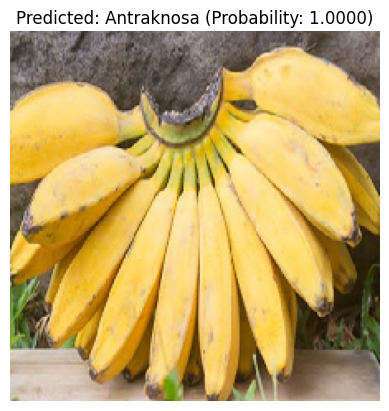

Predicted Label: Antraknosa
Prediction Probability: 1.0000
Predicting images using CNN model...
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step


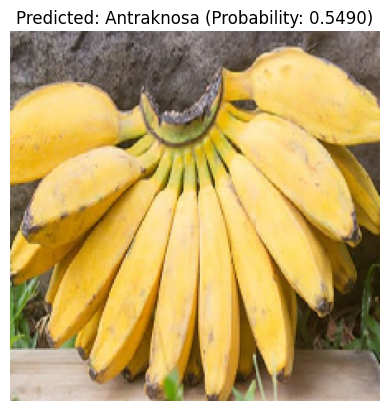

Predicted Label: Antraknosa
Prediction Probability: 0.5490
Predicting images using VGG16 FFE model...
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


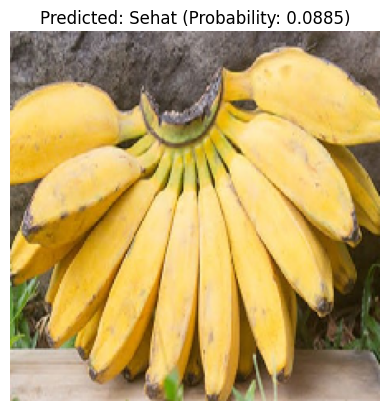

Predicted Label: Sehat
Prediction Probability: 0.0885


In [ ]:
def predict_image(model, img_path):
    # Memuat gambar
    img = image.load_img(img_path, target_size=(224, 224))  # Resize gambar sesuai dengan input model
    img_array = image.img_to_array(img)  # Mengubah gambar menjadi array numpy
    img_array = np.expand_dims(img_array, axis=0)  # Menambahkan batch dimension (model mengharapkan dimensi batch)
    img_array = img_array / 255.0  # Normalisasi piksel gambar ke rentang [0, 1]

    # Melakukan prediksi
    prediction_prob = model.predict(img_array)
    prediction = (prediction_prob > 0.5).astype(int).flatten()  # Menggunakan threshold 0.5 untuk klasifikasi biner

    # Menentukan label berdasarkan prediksi
    label = 'Sehat' if prediction == 0 else 'Antraknosa'
    probability = prediction_prob[0][0]

    return label, probability

# Mengunggah gambar
uploaded = files.upload()  # Memungkinkan pengguna mengunggah file
img_path = next(iter(uploaded))  # Mengambil nama file pertama dari yang diunggah

# Melakukan prediksi
for name, model in models.items():
  print(f"Predicting images using {name} model...")
  label, probability = predict_image(model, img_path)

  # Menampilkan gambar dan hasil prediksi
  img = image.load_img(img_path, target_size=(224, 224))  # Memuat gambar untuk ditampilkan
  plt.imshow(img)
  plt.axis('off')  # Menyembunyikan axis
  plt.title(f"Predicted: {label} (Probability: {probability:.4f})")
  plt.show()

  print(f"Predicted Label: {label}")
  print(f"Prediction Probability: {probability:.4f}")

Saving test crop2.jpg to test crop2.jpg
Predicting images using VGG16 FT model...
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step


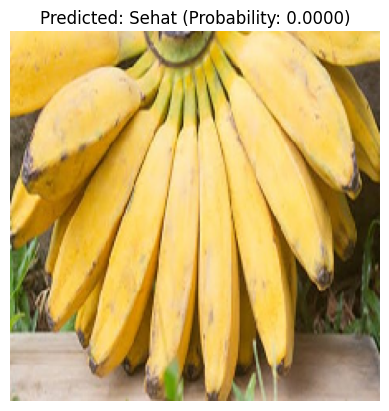

Predicted Label: Sehat
Prediction Probability: 0.0000
Predicting images using CNN model...
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step


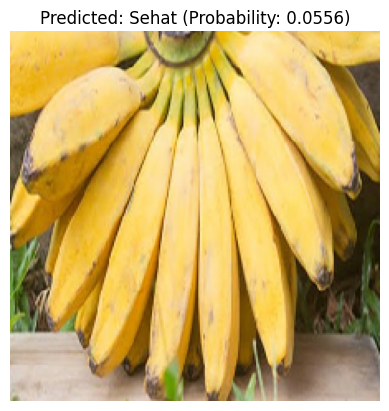

Predicted Label: Sehat
Prediction Probability: 0.0556
Predicting images using VGG16 FFE model...
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step


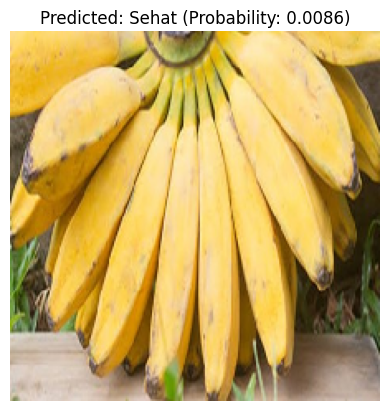

Predicted Label: Sehat
Prediction Probability: 0.0086


In [ ]:
def predict_image(model, img_path):
    # Memuat gambar
    img = image.load_img(img_path, target_size=(224, 224))  # Resize gambar sesuai dengan input model
    img_array = image.img_to_array(img)  # Mengubah gambar menjadi array numpy
    img_array = np.expand_dims(img_array, axis=0)  # Menambahkan batch dimension (model mengharapkan dimensi batch)
    img_array = img_array / 255.0  # Normalisasi piksel gambar ke rentang [0, 1]

    # Melakukan prediksi
    prediction_prob = model.predict(img_array)
    prediction = (prediction_prob > 0.5).astype(int).flatten()  # Menggunakan threshold 0.5 untuk klasifikasi biner

    # Menentukan label berdasarkan prediksi
    label = 'Sehat' if prediction == 0 else 'Antraknosa'
    probability = prediction_prob[0][0]

    return label, probability

# Mengunggah gambar
uploaded = files.upload()  # Memungkinkan pengguna mengunggah file
img_path = next(iter(uploaded))  # Mengambil nama file pertama dari yang diunggah

# Melakukan prediksi
for name, model in models.items():
  print(f"Predicting images using {name} model...")
  label, probability = predict_image(model, img_path)

  # Menampilkan gambar dan hasil prediksi
  img = image.load_img(img_path, target_size=(224, 224))  # Memuat gambar untuk ditampilkan
  plt.imshow(img)
  plt.axis('off')  # Menyembunyikan axis
  plt.title(f"Predicted: {label} (Probability: {probability:.4f})")
  plt.show()

  print(f"Predicted Label: {label}")
  print(f"Prediction Probability: {probability:.4f}")

Saving test crop3.jpg to test crop3.jpg
Predicting images using VGG16 FT model...
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step


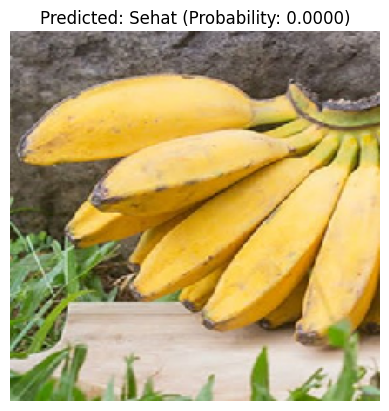

Predicted Label: Sehat
Prediction Probability: 0.0000
Predicting images using CNN model...
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step


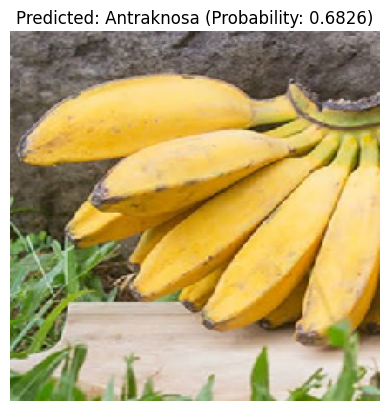

Predicted Label: Antraknosa
Prediction Probability: 0.6826
Predicting images using VGG16 FFE model...
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


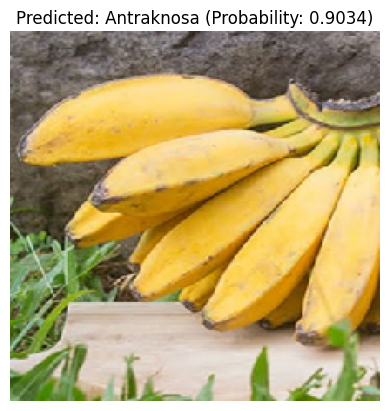

Predicted Label: Antraknosa
Prediction Probability: 0.9034


In [ ]:
def predict_image(model, img_path):
    # Memuat gambar
    img = image.load_img(img_path, target_size=(224, 224))  # Resize gambar sesuai dengan input model
    img_array = image.img_to_array(img)  # Mengubah gambar menjadi array numpy
    img_array = np.expand_dims(img_array, axis=0)  # Menambahkan batch dimension (model mengharapkan dimensi batch)
    img_array = img_array / 255.0  # Normalisasi piksel gambar ke rentang [0, 1]

    # Melakukan prediksi
    prediction_prob = model.predict(img_array)
    prediction = (prediction_prob > 0.5).astype(int).flatten()  # Menggunakan threshold 0.5 untuk klasifikasi biner

    # Menentukan label berdasarkan prediksi
    label = 'Sehat' if prediction == 0 else 'Antraknosa'
    probability = prediction_prob[0][0]

    return label, probability

# Mengunggah gambar
uploaded = files.upload()  # Memungkinkan pengguna mengunggah file
img_path = next(iter(uploaded))  # Mengambil nama file pertama dari yang diunggah

# Melakukan prediksi
for name, model in models.items():
  print(f"Predicting images using {name} model...")
  label, probability = predict_image(model, img_path)

  # Menampilkan gambar dan hasil prediksi
  img = image.load_img(img_path, target_size=(224, 224))  # Memuat gambar untuk ditampilkan
  plt.imshow(img)
  plt.axis('off')  # Menyembunyikan axis
  plt.title(f"Predicted: {label} (Probability: {probability:.4f})")
  plt.show()

  print(f"Predicted Label: {label}")
  print(f"Prediction Probability: {probability:.4f}")

Saving Picture6.jpg to Picture6.jpg
Predicting images using VGG16 FT model...
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step


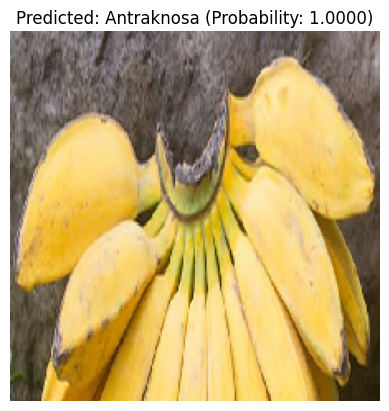

Predicted Label: Antraknosa
Prediction Probability: 1.0000
Predicting images using CNN model...
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step


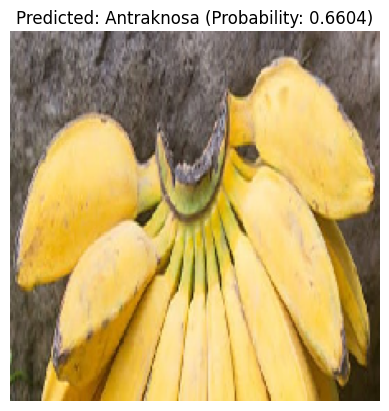

Predicted Label: Antraknosa
Prediction Probability: 0.6604
Predicting images using VGG16 FFE model...
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step


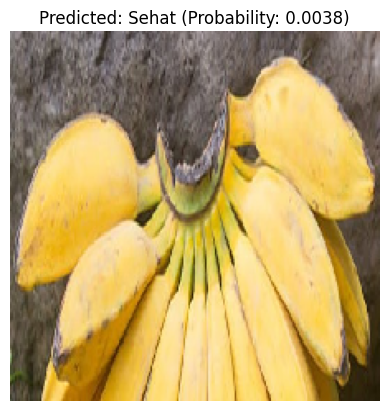

Predicted Label: Sehat
Prediction Probability: 0.0038


In [ ]:
def predict_image(model, img_path):
    # Memuat gambar
    img = image.load_img(img_path, target_size=(224, 224))  # Resize gambar sesuai dengan input model
    img_array = image.img_to_array(img)  # Mengubah gambar menjadi array numpy
    img_array = np.expand_dims(img_array, axis=0)  # Menambahkan batch dimension (model mengharapkan dimensi batch)
    img_array = img_array / 255.0  # Normalisasi piksel gambar ke rentang [0, 1]

    # Melakukan prediksi
    prediction_prob = model.predict(img_array)
    prediction = (prediction_prob > 0.5).astype(int).flatten()  # Menggunakan threshold 0.5 untuk klasifikasi biner

    # Menentukan label berdasarkan prediksi
    label = 'Sehat' if prediction == 0 else 'Antraknosa'
    probability = prediction_prob[0][0]

    return label, probability

# Mengunggah gambar
uploaded = files.upload()  # Memungkinkan pengguna mengunggah file
img_path = next(iter(uploaded))  # Mengambil nama file pertama dari yang diunggah

# Melakukan prediksi
for name, model in models.items():
  print(f"Predicting images using {name} model...")
  label, probability = predict_image(model, img_path)

  # Menampilkan gambar dan hasil prediksi
  img = image.load_img(img_path, target_size=(224, 224))  # Memuat gambar untuk ditampilkan
  plt.imshow(img)
  plt.axis('off')  # Menyembunyikan axis
  plt.title(f"Predicted: {label} (Probability: {probability:.4f})")
  plt.show()

  print(f"Predicted Label: {label}")
  print(f"Prediction Probability: {probability:.4f}")

Saving Picture7.jpg to Picture7.jpg
Predicting images using VGG16 FT model...
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step


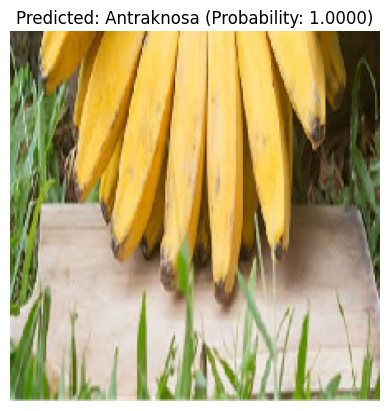

Predicted Label: Antraknosa
Prediction Probability: 1.0000
Predicting images using CNN model...
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step


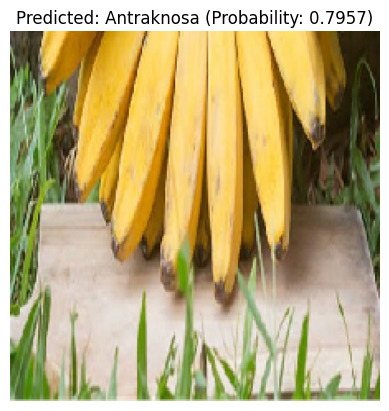

Predicted Label: Antraknosa
Prediction Probability: 0.7957
Predicting images using VGG16 FFE model...
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


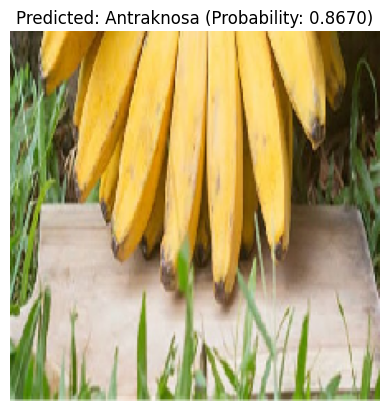

Predicted Label: Antraknosa
Prediction Probability: 0.8670


In [ ]:
def predict_image(model, img_path):
    # Memuat gambar
    img = image.load_img(img_path, target_size=(224, 224))  # Resize gambar sesuai dengan input model
    img_array = image.img_to_array(img)  # Mengubah gambar menjadi array numpy
    img_array = np.expand_dims(img_array, axis=0)  # Menambahkan batch dimension (model mengharapkan dimensi batch)
    img_array = img_array / 255.0  # Normalisasi piksel gambar ke rentang [0, 1]

    # Melakukan prediksi
    prediction_prob = model.predict(img_array)
    prediction = (prediction_prob > 0.5).astype(int).flatten()  # Menggunakan threshold 0.5 untuk klasifikasi biner

    # Menentukan label berdasarkan prediksi
    label = 'Sehat' if prediction == 0 else 'Antraknosa'
    probability = prediction_prob[0][0]

    return label, probability

# Mengunggah gambar
uploaded = files.upload()  # Memungkinkan pengguna mengunggah file
img_path = next(iter(uploaded))  # Mengambil nama file pertama dari yang diunggah

# Melakukan prediksi
for name, model in models.items():
  print(f"Predicting images using {name} model...")
  label, probability = predict_image(model, img_path)

  # Menampilkan gambar dan hasil prediksi
  img = image.load_img(img_path, target_size=(224, 224))  # Memuat gambar untuk ditampilkan
  plt.imshow(img)
  plt.axis('off')  # Menyembunyikan axis
  plt.title(f"Predicted: {label} (Probability: {probability:.4f})")
  plt.show()

  print(f"Predicted Label: {label}")
  print(f"Prediction Probability: {probability:.4f}")

Saving Picture4.jpg to Picture4.jpg
Predicting images using VGG16 FT model...
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step


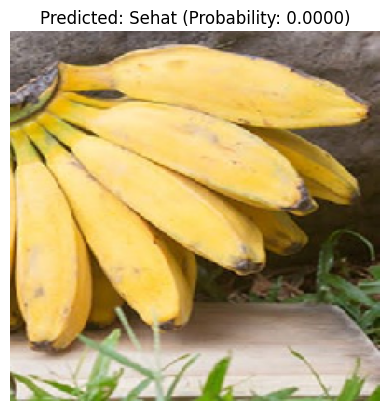

Predicted Label: Sehat
Prediction Probability: 0.0000
Predicting images using CNN model...
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step


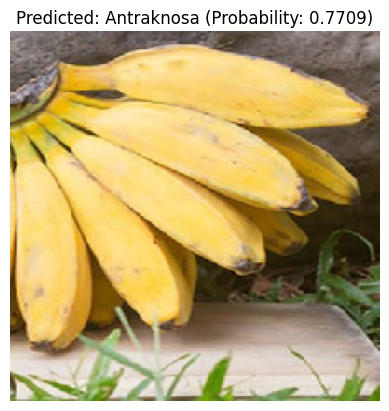

Predicted Label: Antraknosa
Prediction Probability: 0.7709
Predicting images using VGG16 FFE model...
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step


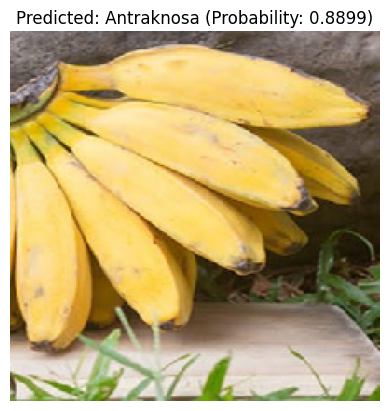

Predicted Label: Antraknosa
Prediction Probability: 0.8899


In [ ]:
def predict_image(model, img_path):
    # Memuat gambar
    img = image.load_img(img_path, target_size=(224, 224))  # Resize gambar sesuai dengan input model
    img_array = image.img_to_array(img)  # Mengubah gambar menjadi array numpy
    img_array = np.expand_dims(img_array, axis=0)  # Menambahkan batch dimension (model mengharapkan dimensi batch)
    img_array = img_array / 255.0  # Normalisasi piksel gambar ke rentang [0, 1]

    # Melakukan prediksi
    prediction_prob = model.predict(img_array)
    prediction = (prediction_prob > 0.5).astype(int).flatten()  # Menggunakan threshold 0.5 untuk klasifikasi biner

    # Menentukan label berdasarkan prediksi
    label = 'Sehat' if prediction == 0 else 'Antraknosa'
    probability = prediction_prob[0][0]

    return label, probability

# Mengunggah gambar
uploaded = files.upload()  # Memungkinkan pengguna mengunggah file
img_path = next(iter(uploaded))  # Mengambil nama file pertama dari yang diunggah

# Melakukan prediksi
for name, model in models.items():
  print(f"Predicting images using {name} model...")
  label, probability = predict_image(model, img_path)

  # Menampilkan gambar dan hasil prediksi
  img = image.load_img(img_path, target_size=(224, 224))  # Memuat gambar untuk ditampilkan
  plt.imshow(img)
  plt.axis('off')  # Menyembunyikan axis
  plt.title(f"Predicted: {label} (Probability: {probability:.4f})")
  plt.show()

  print(f"Predicted Label: {label}")
  print(f"Prediction Probability: {probability:.4f}")

Saving download.webp to download.webp
Predicting images using VGG16 FT model...
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step


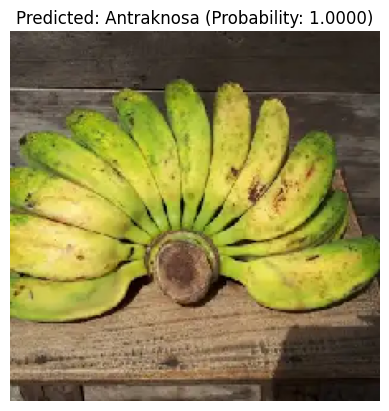

Predicted Label: Antraknosa
Prediction Probability: 1.0000
Predicting images using CNN model...
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step


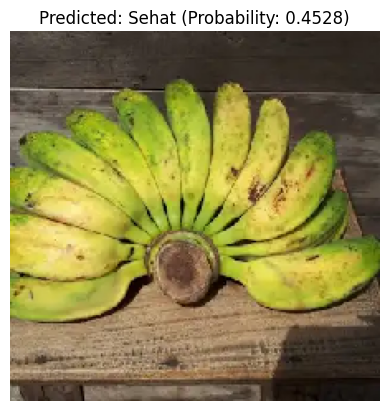

Predicted Label: Sehat
Prediction Probability: 0.4528
Predicting images using VGG16 FFE model...
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step


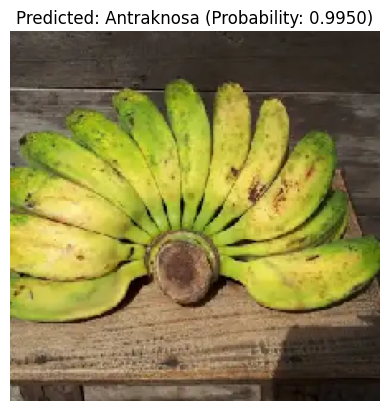

Predicted Label: Antraknosa
Prediction Probability: 0.9950


In [ ]:
def predict_image(model, img_path):
    # Memuat gambar
    img = image.load_img(img_path, target_size=(224, 224))  # Resize gambar sesuai dengan input model
    img_array = image.img_to_array(img)  # Mengubah gambar menjadi array numpy
    img_array = np.expand_dims(img_array, axis=0)  # Menambahkan batch dimension (model mengharapkan dimensi batch)
    img_array = img_array / 255.0  # Normalisasi piksel gambar ke rentang [0, 1]

    # Melakukan prediksi
    prediction_prob = model.predict(img_array)
    prediction = (prediction_prob > 0.5).astype(int).flatten()  # Menggunakan threshold 0.5 untuk klasifikasi biner

    # Menentukan label berdasarkan prediksi
    label = 'Sehat' if prediction == 0 else 'Antraknosa'
    probability = prediction_prob[0][0]

    return label, probability

# Mengunggah gambar
uploaded = files.upload()  # Memungkinkan pengguna mengunggah file
img_path = next(iter(uploaded))  # Mengambil nama file pertama dari yang diunggah

# Melakukan prediksi
for name, model in models.items():
  print(f"Predicting images using {name} model...")
  label, probability = predict_image(model, img_path)

  # Menampilkan gambar dan hasil prediksi
  img = image.load_img(img_path, target_size=(224, 224))  # Memuat gambar untuk ditampilkan
  plt.imshow(img)
  plt.axis('off')  # Menyembunyikan axis
  plt.title(f"Predicted: {label} (Probability: {probability:.4f})")
  plt.show()

  print(f"Predicted Label: {label}")
  print(f"Prediction Probability: {probability:.4f}")

Saving download (1).jpeg to download (1).jpeg
Predicting images using VGG16 FT model...
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step


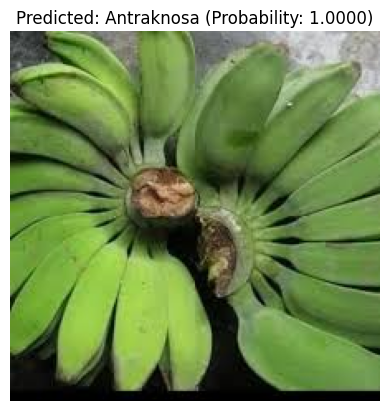

Predicted Label: Antraknosa
Prediction Probability: 1.0000
Predicting images using CNN model...
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step


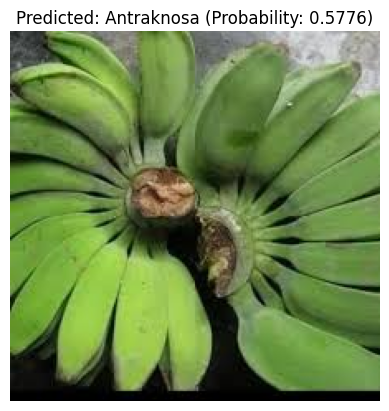

Predicted Label: Antraknosa
Prediction Probability: 0.5776
Predicting images using VGG16 FFE model...
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step


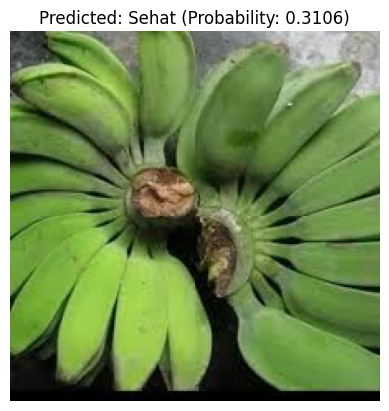

Predicted Label: Sehat
Prediction Probability: 0.3106


In [ ]:
def predict_image(model, img_path):
    # Memuat gambar
    img = image.load_img(img_path, target_size=(224, 224))  # Resize gambar sesuai dengan input model
    img_array = image.img_to_array(img)  # Mengubah gambar menjadi array numpy
    img_array = np.expand_dims(img_array, axis=0)  # Menambahkan batch dimension (model mengharapkan dimensi batch)
    img_array = img_array / 255.0  # Normalisasi piksel gambar ke rentang [0, 1]

    # Melakukan prediksi
    prediction_prob = model.predict(img_array)
    prediction = (prediction_prob > 0.5).astype(int).flatten()  # Menggunakan threshold 0.5 untuk klasifikasi biner

    # Menentukan label berdasarkan prediksi
    label = 'Sehat' if prediction == 0 else 'Antraknosa'
    probability = prediction_prob[0][0]

    return label, probability

# Mengunggah gambar
uploaded = files.upload()  # Memungkinkan pengguna mengunggah file
img_path = next(iter(uploaded))  # Mengambil nama file pertama dari yang diunggah

# Melakukan prediksi
for name, model in models.items():
  print(f"Predicting images using {name} model...")
  label, probability = predict_image(model, img_path)

  # Menampilkan gambar dan hasil prediksi
  img = image.load_img(img_path, target_size=(224, 224))  # Memuat gambar untuk ditampilkan
  plt.imshow(img)
  plt.axis('off')  # Menyembunyikan axis
  plt.title(f"Predicted: {label} (Probability: {probability:.4f})")
  plt.show()

  print(f"Predicted Label: {label}")
  print(f"Prediction Probability: {probability:.4f}")

Saving pisang-kepok-gerecek.webp to pisang-kepok-gerecek.webp
Predicting images using VGG16 FT model...
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step


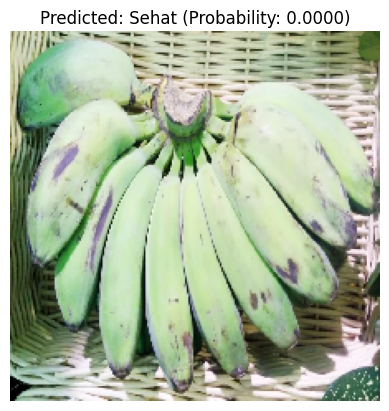

Predicted Label: Sehat
Prediction Probability: 0.0000
Predicting images using CNN model...
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step


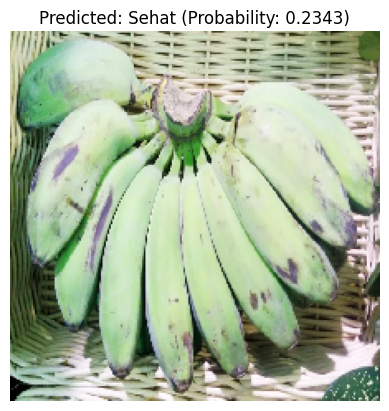

Predicted Label: Sehat
Prediction Probability: 0.2343
Predicting images using VGG16 FFE model...
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step


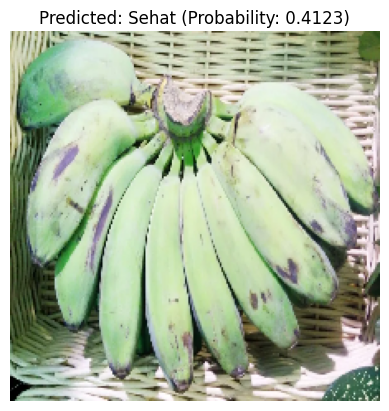

Predicted Label: Sehat
Prediction Probability: 0.4123


In [ ]:
def predict_image(model, img_path):
    # Memuat gambar
    img = image.load_img(img_path, target_size=(224, 224))  # Resize gambar sesuai dengan input model
    img_array = image.img_to_array(img)  # Mengubah gambar menjadi array numpy
    img_array = np.expand_dims(img_array, axis=0)  # Menambahkan batch dimension (model mengharapkan dimensi batch)
    img_array = img_array / 255.0  # Normalisasi piksel gambar ke rentang [0, 1]

    # Melakukan prediksi
    prediction_prob = model.predict(img_array)
    prediction = (prediction_prob > 0.5).astype(int).flatten()  # Menggunakan threshold 0.5 untuk klasifikasi biner

    # Menentukan label berdasarkan prediksi
    label = 'Sehat' if prediction == 0 else 'Antraknosa'
    probability = prediction_prob[0][0]

    return label, probability

# Mengunggah gambar
uploaded = files.upload()  # Memungkinkan pengguna mengunggah file
img_path = next(iter(uploaded))  # Mengambil nama file pertama dari yang diunggah

# Melakukan prediksi
for name, model in models.items():
  print(f"Predicting images using {name} model...")
  label, probability = predict_image(model, img_path)

  # Menampilkan gambar dan hasil prediksi
  img = image.load_img(img_path, target_size=(224, 224))  # Memuat gambar untuk ditampilkan
  plt.imshow(img)
  plt.axis('off')  # Menyembunyikan axis
  plt.title(f"Predicted: {label} (Probability: {probability:.4f})")
  plt.show()

  print(f"Predicted Label: {label}")
  print(f"Prediction Probability: {probability:.4f}")